# Prediction of gene expression values from the latent space trained on HVGs

In [1]:
import numpy as np
import scanpy as sc
import anndata as ad
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

from sklearn.metrics import r2_score
from scipy.stats import pearsonr

sc.set_figure_params(dpi=100, frameon=False, color_map='Reds', facecolor=None)
sc.logging.print_versions()

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


-----
anndata     0.7.6
scanpy      1.8.2
sinfo       0.3.1
-----
PIL                         8.4.0
anndata                     0.7.6
backcall                    0.2.0
cffi                        1.14.1
cloudpickle                 2.0.0
colorama                    0.4.4
cycler                      0.10.0
cython_runtime              NA
dask                        2021.06.0
dateutil                    2.8.2
debugpy                     1.5.1
decorator                   5.1.0
defusedxml                  0.7.1
entrypoints                 0.3
fsspec                      2021.05.0
google                      NA
h5py                        2.9.0
igraph                      0.8.3
ipykernel                   6.5.0
ipython_genutils            0.2.0
ipywidgets                  7.6.5
jedi                        0.18.1
joblib                      1.1.0
kiwisolver                  1.3.2
leidenalg                   0.8.3
llvmlite                    0.37.0
matplotlib                  3.5.0
matplotlib_i

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
project_dir = "/lustre/groups/ml01/workspace/hlca_lisa.sikkema_malte.luecken/HLCA_reproducibility"
original_adata_path = f'{project_dir}/data/HLCA_core_h5ads/HLCA_v1.h5ad'
reference_model_path = f'{project_dir}/results/scANVI_integration/scanvi_model'

Observe clustering before reconstruction. Note: importing pytorch (via `scvi`) may cause LLVM conflicts and prevent numba -> `sc.pp.neighbors` to work.

In [4]:
full_adata = sc.read(original_adata_path)
full_adata

AnnData object with n_obs × n_vars = 584884 × 28527
    obs: 'sample', 'original_celltype_ann', 'study_long', 'study', 'last_author_PI', 'subject_ID', 'subject_ID_as_published', 'pre_or_postnatal', 'age_in_years', 'age_range', 'sex', 'ethnicity', 'mixed_ethnicity', 'smoking_status', 'smoking_history', 'BMI', 'known_lung_disease', 'condition', 'subject_type', 'cause_of_death', 'sample_type', 'anatomical_region_coarse', 'anatomical_region_detailed', 'tissue_dissociation_protocol', 'cells_or_nuclei', 'single_cell_platform', "3'_or_5'", 'enrichment', 'sequencing_platform', 'reference_genome_coarse', 'ensembl_release_reference_genome', 'cell_ranger_version', 'disease_status', 'fresh_or_frozen', 'cultured', 'cell_viability_%', 'comments', 'Processing_site', 'dataset', 'anatomical_region_level_1', 'anatomical_region_level_2', 'anatomical_region_level_3', 'anatomical_region_highest_res', 'age', 'original_ann_level_1', 'original_ann_level_2', 'original_ann_level_3', 'original_ann_level_4', 'ori

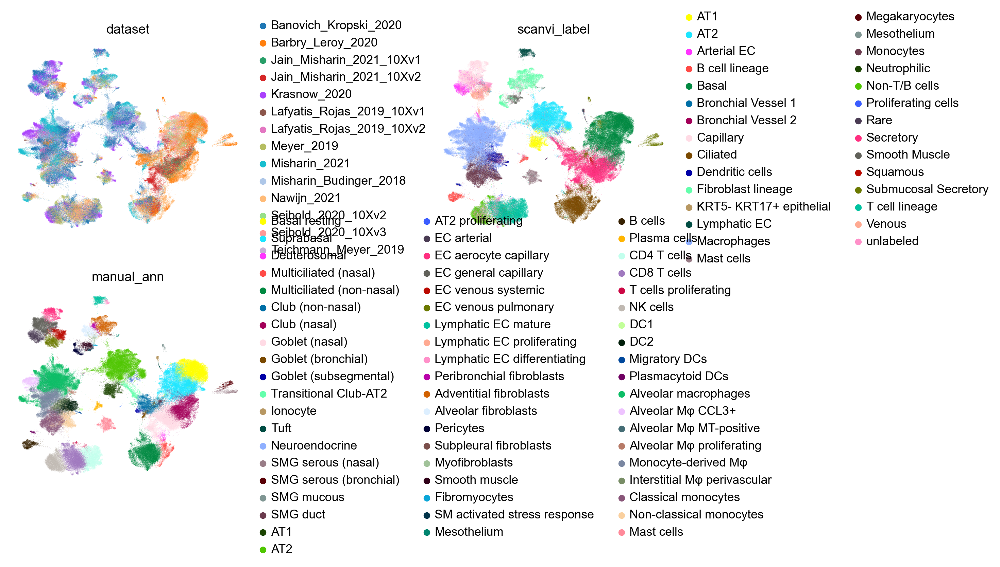

In [6]:
sc.pl.umap(full_adata, color=['dataset', 'scanvi_label', 'manual_ann'], ncols=2, wspace=.6)

We'll run the example on a subset of the cells to reduce runtime.

In [5]:
hvgs = full_adata.var_names[full_adata.var['highly_variable']]
nonhvgs = full_adata.var_names[~full_adata.var['highly_variable']]
subset = full_adata[:, hvgs][full_adata.obs.scanvi_label.isin(['Secretory', 'Ciliated'])]

Let's visualize what the data looks like with no integration - a UMAP of the variation captured by HVG expression with no correction. We see that there is distinct batch effect between certain datasets, but also much biological variation within a cell type label.

2022-07-18 03:02:07.745965: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


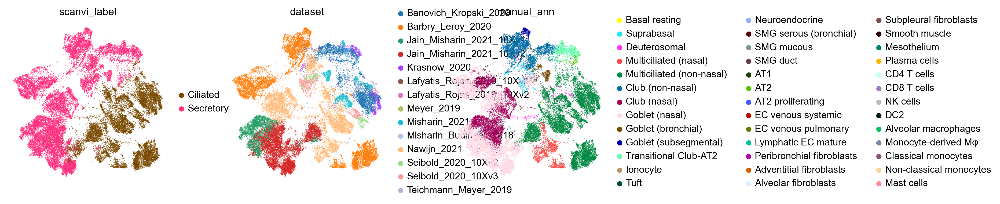

CPU times: user 5min 12s, sys: 56.6 s, total: 6min 8s
Wall time: 4min 26s


In [11]:
%%time
sc.tl.pca(subset)
sc.pp.neighbors(subset)
sc.tl.umap(subset)
sc.pl.umap(subset, color=['scanvi_label', 'dataset', 'manual_ann'], ncols=2, wspace=.6)

## convert legacy scANVI model (skip on rerun)

Copy the legacy model directory over and instantiate new model inside.

In [6]:
!cp -r /lustre/groups/ml01/workspace/hlca_lisa.sikkema_malte.luecken/HLCA_reproducibility/results/scANVI_integration/scanvi_model/ ~/projects/hlca

In [7]:
import scvi

# convert old model to new version
scvi.model.SCANVI.convert_legacy_save(
    dir_path=reference_model_path,
    output_dir_path="./scanvi_model/",
    overwrite=True
)

Global seed set to 0


## load source model

This produces a corrected gene expression matrix where all batches have been aligned to the same batch.

In [6]:
import torch
import scvi
print(scvi.__version__)

adata = full_adata[:, hvgs].copy()
source_model = scvi.model.SCANVI.load('./scanvi_model/', adata)
source_model

Global seed set to 0


0.16.3
INFO     File ./scanvi_model/model.pt already downloaded                                     


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/model/base/_utils.py:135: UserWarning: var_names for adata passed in does not match var_names of adata used to train the model. For valid results, the vars need to be the same and in the same order as the adata used to train the model.
  "var_names for adata passed in does not match var_names of "
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/data/fields/_layer_field.py:79: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  f"{logger_data_loc} does not contain unnormalized count data. "
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/data/_utils.py:158: UserWarning: Category 18 in adata.obs['_scvi_labels'] has fewer than 3 cells. Models may not train properly.
  category, alternate_column_key


ScanVI Model with the following params: 
unlabeled_category: unlabeled, n_hidden: 128, n_latent: 30, n_layers: 2, dropout_rate: 0.1, 
dispersion: gene, gene_likelihood: nb
Training status: Trained

In [7]:
source_model.summary_stats

attrdict({'n_cells': 584884, 'n_vars': 2000, 'n_batch': 14, 'n_labels': 29, 'n_extra_categorical_covs': 0, 'n_extra_continuous_covs': 0})

## reconstruct into the same batch with original model (HVGs)

Here, we have chosen to reconstruct onto the Barbry-Leroy 2020 using the in-built functionality of specifying the target batch in scANVI. We choose this dataset because it exhibits two distinct populations within the Secretory label.

In [18]:
target_batch = 'Barbry_Leroy_2020'
recon = source_model.get_normalized_expression(subset, transform_batch=target_batch)

# construct anndata
recon_adata = ad.AnnData(recon, obs=subset.obs, var=subset.var)
recon_adata.uns['scanvi_label_colors'] = subset.uns['scanvi_label_colors']

INFO     Received view of anndata, making copy.                                              
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


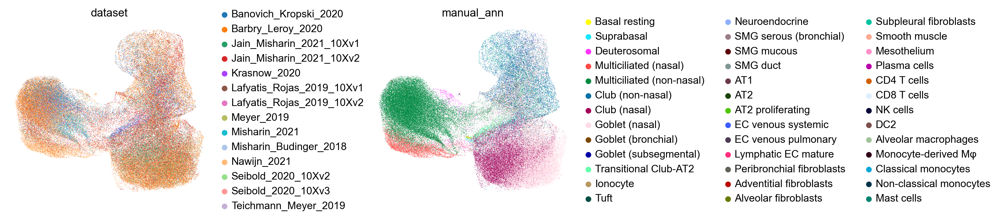

CPU times: user 3min 20s, sys: 5.44 s, total: 3min 26s
Wall time: 2min 9s


In [15]:
%%time
sc.tl.pca(recon_adata)
sc.pp.neighbors(recon_adata)
sc.tl.umap(recon_adata)
sc.pl.umap(recon_adata, color=['dataset', 'manual_ann'], wspace=.6)

The batch effects are far more corrected now than in the original gene space, which is good, but we also lose much of the original resolution of the labels which were not trained on. Notable disappearance: the difference between nasal and non-nasal samples. Notable maintained variation: the rare cell type deuterosomal cells still approximately form their own cluster.

## reconstruct full gene expression space

Although we now have the "corrected" gene expression matrix, we still don't have expression values for all the genes. We will now impute the remaining genes from the latent space by extending the model. We prefer this to typical imputation approaches because it uses the existing model's knowledge of the latent variables (both latent embedding and categorical features) to infer the remaining information.

In [8]:
full_subset = full_adata[full_adata.obs.scanvi_label.isin(['Secretory', 'Ciliated'])].copy()

### with linear regression (baseline, no categorical information)

In [9]:
# get latent layer
z = source_model.get_latent_representation(subset)

INFO     Received view of anndata, making copy.                                              
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


In [10]:
# demonstrate imputation with linear regression as a baseline
from sklearn.linear_model import LinearRegression

reg = LinearRegression()
reg.fit(z, full_subset.X.toarray())

LinearRegression()

Measure performance:

In [11]:
pred = reg.predict(z)
print('all:', r2_score(full_subset.X.toarray(), pred))  # same as reg.score()
print('hvgs:', r2_score(full_subset[:, hvgs].X.toarray(), pred[:, full_adata.var['highly_variable'].values]))
print('non-hvgs:', r2_score(full_subset[:, nonhvgs].X.toarray(), pred[:, ~full_adata.var['highly_variable'].values]))

all: 0.043266138577315406
hvgs: 0.11125040869419751
non-hvgs: 0.03814047264321942


In [12]:
full_subset.layers['linreg_pred'] = pred

/home/icb/yuge.ji/miniconda3/envs/py38_analysis/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/home/icb/yuge.ji/miniconda3/envs/py38_analysis/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/yuge.ji/miniconda3/envs/py38_analysis/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/yuge.ji/miniconda3/envs/py38_analysis/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = sca

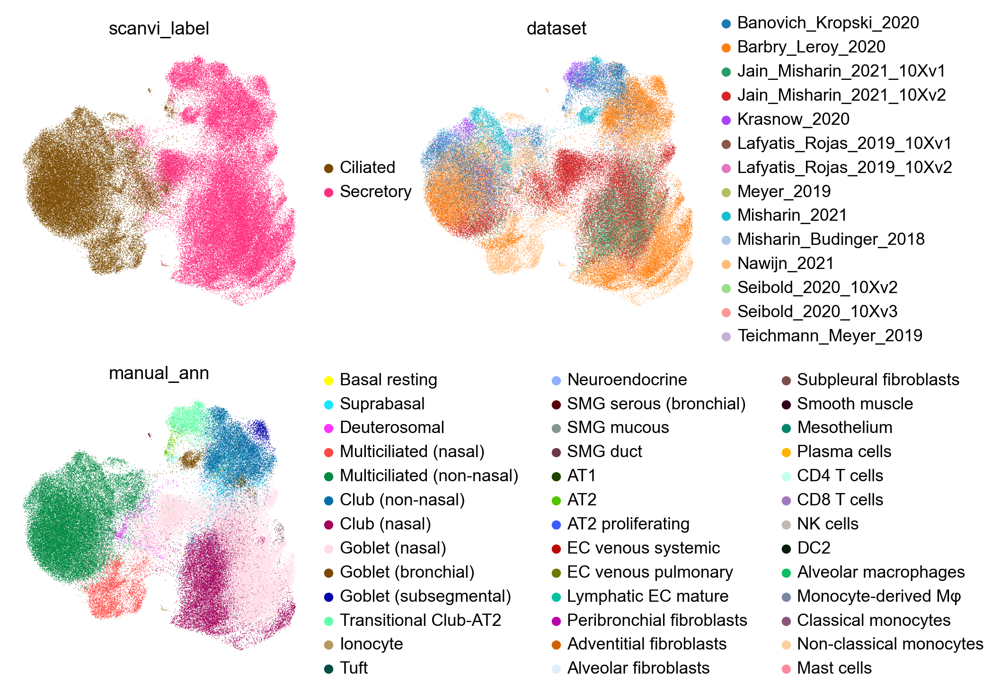

CPU times: user 5min 13s, sys: 1min 39s, total: 6min 52s
Wall time: 3min 13s


In [5]:
%%time
fs_copy = full_subset.copy()
fs_copy.X = fs_copy.layers['linreg_pred']

sc.tl.pca(fs_copy)
sc.pp.neighbors(fs_copy)
sc.tl.umap(fs_copy)
sc.pl.umap(fs_copy, color=['scanvi_label', 'dataset', 'manual_ann'])

The latent embedding contains very little batch information and thus, this model cannot learn to reconstruct sources of variation related to batch, producing a very integrated UMAP which still recapitulates variation in the secretory cells.

### with modified model

To do this, we will instantiate a new model with the same architecture, but more features. We then set additional input feature weights to zero and freeze everything except the decoder.

Modify based on https://github.com/scverse/scvi-tools/blob/096099e34568b1bf94aad5273b9f92c202c9c755/scvi/model/base/_archesmixin.py#L125-L138

In [9]:
attr_dict, var_names, old_state_dict = scvi.model.base._archesmixin._get_loaded_data(source_model)
# instantiate new model with updated sizes
source_model.setup_anndata(full_adata, **attr_dict['registry_']['setup_args'])
new_model = scvi.model.SCANVI(
    full_adata,
    **source_model.init_params_['non_kwargs'],
    **source_model.init_params_['kwargs']['model_kwargs'],
)
new_model.to_device(source_model.device)

# get new tensors
_, new_var_names, new_state_dict = scvi.model.base._archesmixin._get_loaded_data(new_model)

# model tweaking
n_feat_new = len(new_var_names)
feature_indices = [list(new_var_names).index(g) for g in var_names]  # kinda slow
batch_indices = list(range(n_feat_new, n_feat_new+source_model.adata_manager.summary_stats['n_batch']))
for key, old_ten in old_state_dict.items():
    new_ten = new_state_dict[key]
    # new features in encoder first layer, but set weights to zero since unused
    if 'z_encoder' in key or 'l_encoder' in key:
        if new_ten.size() == old_ten.size():  # should be true for layers following first
            print(f'same size, skipping {key}')
            continue
        else:
            print('adjusting', key)
            zero_weights = torch.zeros(new_ten.size(), device=source_model.device)
            zero_weights[:, feature_indices + batch_indices] = old_ten
            old_state_dict[key] = zero_weights
    # new features in last layer of decoder     
    if 'decoder.px' in key or 'px_r' in key:
        if new_ten.size() == old_ten.size():
            print(f'same size, skipping {key}')
            continue
        else:
            print('adjusting', key)
            try:
                new_ten[feature_indices, :] = old_ten
            except:  # single dimension bias
                new_ten[feature_indices] = old_ten
            old_state_dict[key] = new_ten

adjusting px_r
adjusting z_encoder.encoder.fc_layers.Layer 0.0.weight
same size, skipping z_encoder.encoder.fc_layers.Layer 0.0.bias
same size, skipping z_encoder.encoder.fc_layers.Layer 1.0.weight
same size, skipping z_encoder.encoder.fc_layers.Layer 1.0.bias
same size, skipping z_encoder.mean_encoder.weight
same size, skipping z_encoder.mean_encoder.bias
same size, skipping z_encoder.var_encoder.weight
same size, skipping z_encoder.var_encoder.bias
adjusting l_encoder.encoder.fc_layers.Layer 0.0.weight
same size, skipping l_encoder.encoder.fc_layers.Layer 0.0.bias
same size, skipping l_encoder.mean_encoder.weight
same size, skipping l_encoder.mean_encoder.bias
same size, skipping l_encoder.var_encoder.weight
same size, skipping l_encoder.var_encoder.bias
same size, skipping decoder.px_decoder.fc_layers.Layer 0.0.weight
same size, skipping decoder.px_decoder.fc_layers.Layer 0.0.bias
same size, skipping decoder.px_decoder.fc_layers.Layer 1.0.weight
same size, skipping decoder.px_decode

In [10]:
# replace
new_model.module.load_state_dict(old_state_dict)

<All keys matched successfully>

Freeze everything except the decoder.

In [11]:
def requires_grad(key):
    """Returns whether the module should be allowed to train.
    """
    return 'decoder' in key and 'px' in key

for key, mod in new_model.module.named_parameters():
    if not requires_grad(key):
        mod.requires_grad = False

#### Train.

In [22]:
new_model.train(max_epochs=10)

INFO     Training for 10 epochs.                                                             


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (ElboMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 2/10:  10%|█████████████████▊                                                                                                                                                                | 1/10 [09:17<1:23:36, 557.34s/it, loss=4.7e+03, v_num=1]

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/pytorch_lightning/trainer/trainer.py:688: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [23]:
# save model
new_model.save('scanvi_model_full_genes_full_data', overwrite=True)
# new_model.save('scanvi_model_full_genes', overwrite=True)

INFO     File scanvi_model_full_genes_full_data/model.pt already downloaded                  


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/data/fields/_layer_field.py:79: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  f"{logger_data_loc} does not contain unnormalized count data. "
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/data/_utils.py:158: UserWarning: Category 18 in adata.obs['_scvi_labels'] has fewer than 3 cells. Models may not train properly.
  category, alternate_column_key


ScanVI Model with the following params: 
unlabeled_category: unlabeled, n_hidden: 128, n_latent: 30, n_layers: 2, dropout_rate: 0.1, 
dispersion: gene, gene_likelihood: nb
Training status: Trained

Check that 10 epochs was enough:

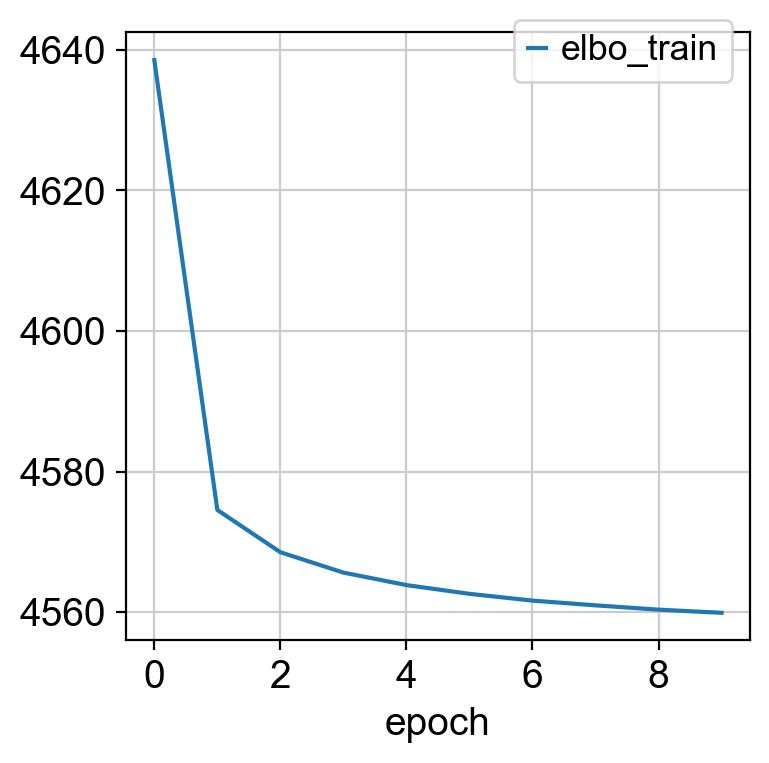

In [30]:
pd.concat(new_model.history.values(), axis=1).reset_index().plot('epoch', ['elbo_train'])
plt.legend(bbox_to_anchor=(1, 1.05))

Verify that the embeddings produced by the old model and the new model are the same.

In [27]:
assert np.isclose(
    new_model.get_latent_representation(full_subset).sum(0)[0],
    source_model.get_latent_representation(subset).sum(0)[0],
    rtol=1e-4)

### load new model

In [12]:
new_model = scvi.model.SCANVI.load('./scanvi_model_full_genes/', full_adata)

INFO     File ./scanvi_model_full_genes/model.pt already downloaded                          


Check that batch correction is preserved as in the example above:

In [31]:
target_batch = 'Barbry_Leroy_2020'
recon = new_model.get_normalized_expression(full_subset, transform_batch=target_batch)

# construct anndata
recon_adata = ad.AnnData(recon, obs=full_subset.obs, var=full_subset.var)
recon_adata.uns['scanvi_label_colors'] = full_subset.uns['scanvi_label_colors']

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/data/fields/_layer_field.py:79: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  f"{logger_data_loc} does not contain unnormalized count data. "


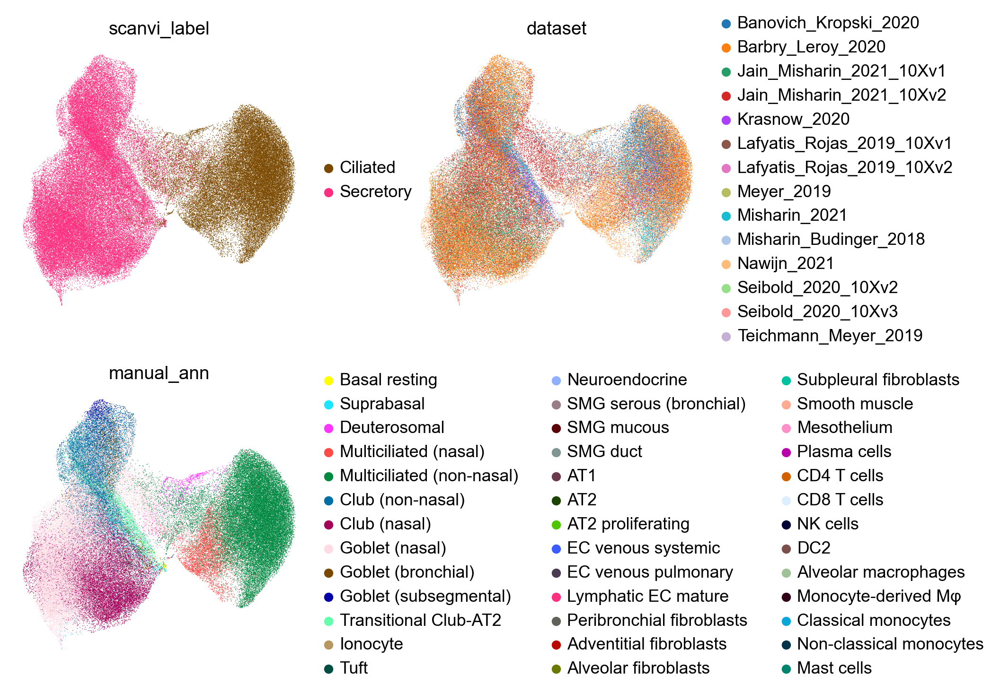

In [9]:
%%time
sc.tl.pca(recon_adata)
sc.pp.neighbors(recon_adata)
sc.tl.umap(recon_adata)
sc.pl.umap(recon_adata, color=['scanvi_label', 'dataset', 'manual_ann'], ncols=2)

Unlike in the example above, the multi-layer decoder does not manage to be as powerful as the single-layer linear regression in preserving secretory cell subtypes, even though Barbry-Leroy 2020 contains them.

### result of passing a completely 0 batch
I've modified the forward pass of `DecoderSCVI` to permanently pass zeros instead of a one-hot for this portion of the notebook.

```
cat_list = (                                                                                                               torch.zeros(cat_list[0].shape[0], self.px_decoder.n_cat_list[0]),                                                     *cat_list[1:]                                                                                                      )         
```

In [12]:
scvi.__file__

'/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/__init__.py'

In [ ]:
recon = new_model.get_normalized_expression(full_subset)

recon_adata = ad.AnnData(recon, obs=full_subset.obs, var=full_subset.var)
recon_adata.uns['scanvi_label_colors'] = full_subset.uns['scanvi_label_colors']

/home/icb/yuge.ji/miniconda3/envs/py38_analysis/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: PendingDeprecationWarning: The get_cmap function will be deprecated in a future version. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/home/icb/yuge.ji/miniconda3/envs/py38_analysis/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/yuge.ji/miniconda3/envs/py38_analysis/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/yuge.ji/miniconda3/envs/py38_analysis/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = sca

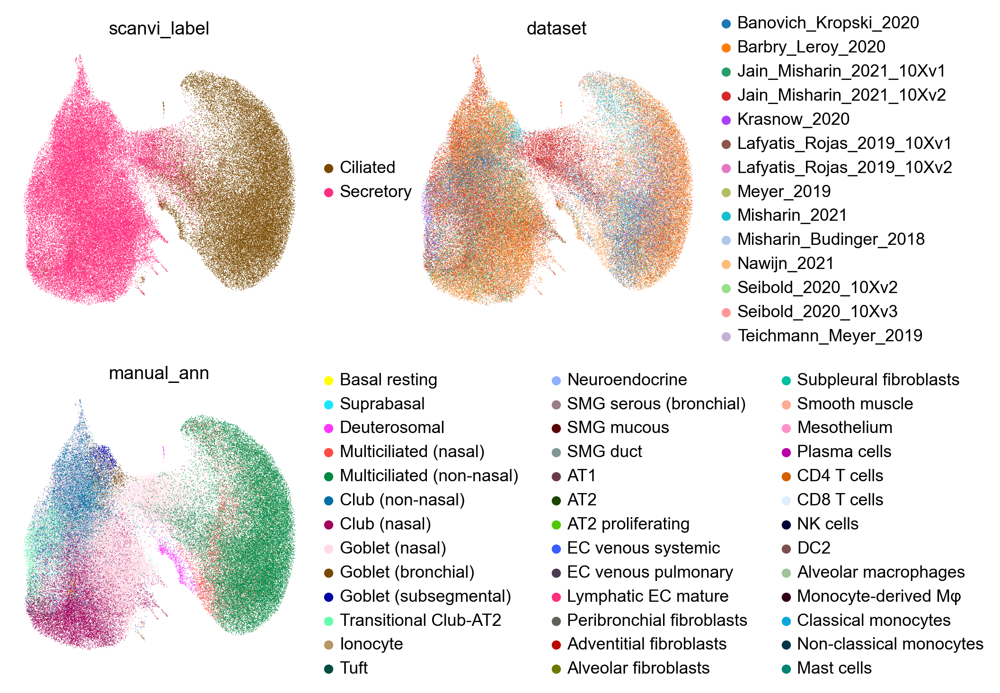

CPU times: user 15min 35s, sys: 2min 43s, total: 18min 18s
Wall time: 2min 57s


In [29]:
%%time
sc.tl.pca(recon_adata, use_highly_variable=False)
sc.pp.neighbors(recon_adata)
sc.tl.umap(recon_adata)
sc.pl.umap(recon_adata, color=['scanvi_label', 'dataset', 'manual_ann'], ncols=2)

Similiar to the UMAP above, we mostly see excessive batch correction in this null batch, full gene-set reconstruction. Perhaps surprisingly, there's not much difference between passing a real batch and a null batch.

#### removal of batch effect

In [23]:
recon_adata.write('recon_test.h5ad')

In [10]:
example_subset = full_adata[full_adata.obs.scanvi_label.isin(['Macrophages', 'AT1', 'AT2'])]

Misharin_Budinger_2018


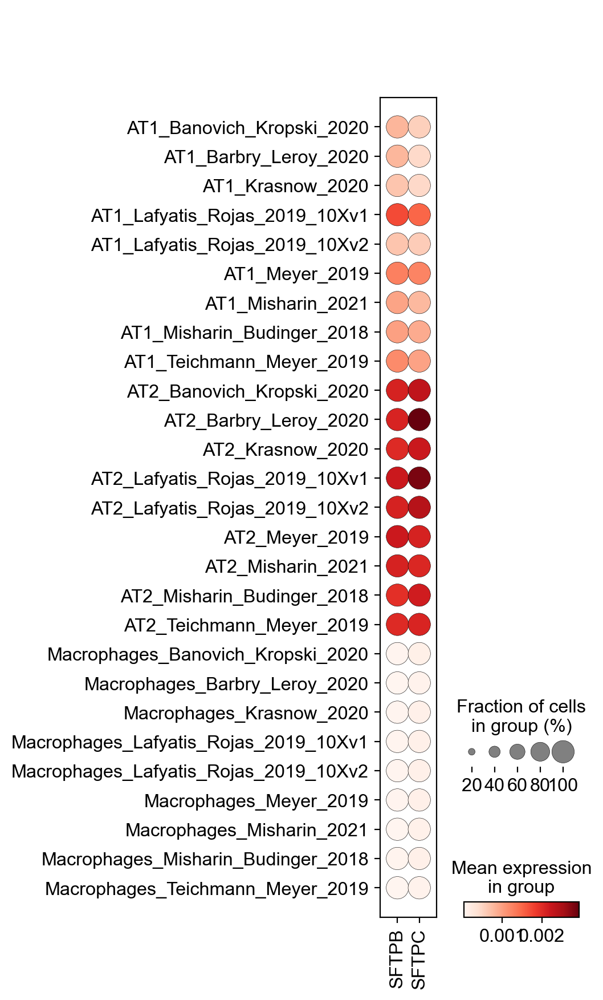

Krasnow_2020


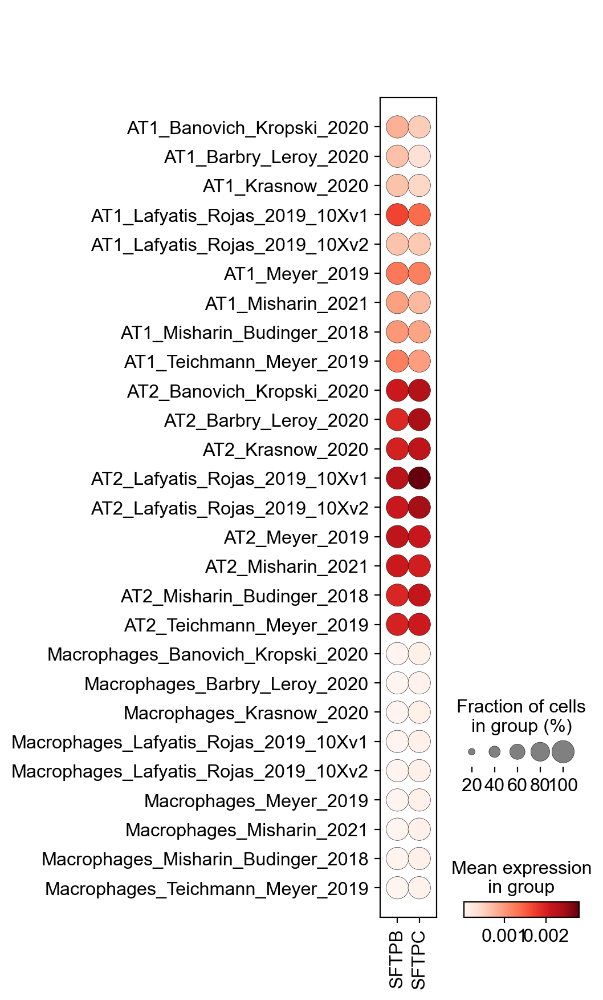

CPU times: user 18min 1s, sys: 1min 9s, total: 19min 11s
Wall time: 1min 31s


In [13]:
%%time
for target_batch in adata.obs.dataset.unique()[:2]:  # these are all the same, but just to prove it to you
    print(target_batch)
    recon = new_model.get_normalized_expression(example_subset, transform_batch=target_batch)

    # construct anndata
    recon_adata = ad.AnnData(recon, obs=example_subset.obs, var=example_subset.var)
    recon_adata.uns['scanvi_label_colors'] = example_subset.uns['scanvi_label_colors']
    sc.pl.dotplot(recon_adata, var_names=['SFTPB', 'SFTPC'], groupby=['scanvi_label', 'dataset'])

## performance

In [17]:
# linear regression reconstruction
linreg_recon = full_subset.to_df(layer='linreg_pred')
# original HLCA model reconstruction, null batch
source_recon = source_model.get_normalized_expression(subset, transform_batch=None)
# full gene set reconstruction, null batch
new_recon = new_model.get_normalized_expression(full_subset, transform_batch=None)

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


In [25]:
# because anndata write is faster than pandas write
ad.AnnData(linreg_recon).write('linreg_recon.h5ad')
ad.AnnData(source_recon).write('source_recon.h5ad')
ad.AnnData(new_recon).write('new_recon.h5ad')

In [14]:
# load in save files
linreg_recon = sc.read('linreg_recon.h5ad').to_df()
source_recon = sc.read('source_recon.h5ad').to_df()
new_recon = sc.read('new_recon.h5ad').to_df()

In [15]:
orig_expr = full_subset.to_df()

In [16]:
# get a random result
index = np.arange(full_subset.shape[0])
np.random.shuffle(index)
random_recon = full_subset[index].to_df()

In [17]:
res_dict = {
    'linreg': linreg_recon,
    'original scANVI': source_recon,
    'tuned scANVi': new_recon,
    'random': random_recon
}

### via correlation of reconstructed values

Measure performance of reconstructed gene expression values:

In [26]:
def loop_pearson(A, B):
    dia = []
    for i in range(A.shape[1]):
        dia.append(pearsonr(A.values[:, i], B.values[:, i])[0])
    return dia
        
def construct_res_df(true_df, pred_df, has_hvgs=True):
    if has_hvgs:
        gene_cats = {
            'hvg': hvgs,
            'non-hvg': nonhvgs
        }
    else:
        gene_cats = {
            'hvg': hvgs
        }
    res = {}
    dfs = []
    for name, cat in gene_cats.items():
        res[name] = {
            'pearson': loop_pearson(true_df[cat], pred_df[cat]),
            'r2': r2_score(true_df[cat].values, pred_df[cat].values, multioutput='raw_values')
        }
        
        df = pd.DataFrame.from_dict(res[name])
        df['source'] = name
        df['genes'] = cat
        dfs.append(df)

    return pd.concat(dfs), res

In [12]:
%%time
df, res = construct_res_df(orig_expr, new_recon)

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


CPU times: user 53min 40s, sys: 32min 22s, total: 1h 26min 3s
Wall time: 6min 43s


<AxesSubplot:xlabel='variable', ylabel='value'>

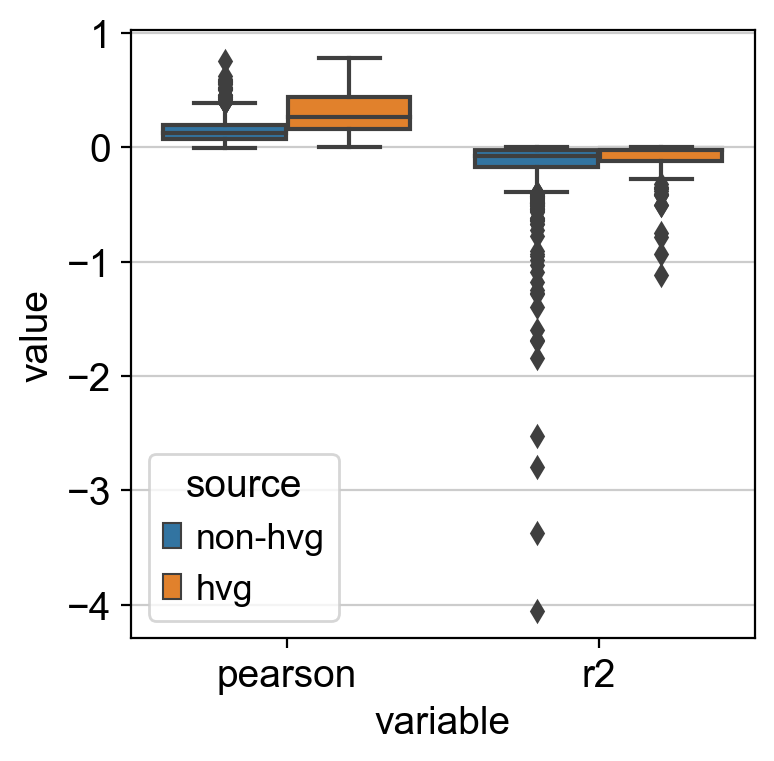

In [109]:
sns.boxplot(x='variable', y='value', data=df.melt(id_vars=['source']), hue='source')

In [36]:
%%time
dfs = []
for recon_name, recon in res_dict.items():
    df, res = construct_res_df(orig_expr, recon, recon_name != 'original scANVI')
    df['model'] = recon_name
    dfs.append(df)
    display(df.head(3))

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


,pearson,r2,source,genes,model
0,0.160287,0.025692,hvg,FGR,linreg
1,0.321605,0.103430,hvg,CFH,linreg
2,0.421285,0.177481,hvg,HS3ST1,linreg


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


,pearson,r2,source,genes,model
0,0.123439,-0.002012,hvg,FGR,original scANVI
1,0.136226,-0.352905,hvg,CFH,original scANVI
2,0.174610,-0.377229,hvg,HS3ST1,original scANVI


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


,pearson,r2,source,genes,model
0,0.175498,-0.002307,hvg,FGR,tuned scANVi
1,0.195065,-0.353695,hvg,CFH,tuned scANVi
2,0.223299,-0.377953,hvg,HS3ST1,tuned scANVi


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


,pearson,r2,source,genes,model
0,-0.002384,-1.004769,hvg,FGR,random
1,-0.000119,-1.000238,hvg,CFH,random
2,0.002127,-0.995747,hvg,HS3ST1,random


CPU times: user 2h 17min 35s, sys: 1h 20min 27s, total: 3h 38min 2s
Wall time: 17min 45s


In [110]:
res_df = pd.concat(dfs)
res_df['model'] = res_df['model'].replace({'tuned scANVi': 'tuned scANVI'})  # ...I can't spell

In [81]:
# save dataframe of results
df.to_csv('full_geneset_reconstruction_results.csv')

In [111]:
res_df['source'] = res_df['model'].astype(str) + ' (' + res_df.source.astype(str) + ')'

In [115]:
hue_order = ['random (hvg)', 'random (non-hvg)', 'linreg (hvg)', 'linreg (non-hvg)', 'tuned scANVI (hvg)', 'tuned scANVI (non-hvg)', 'original scANVI (hvg)']

Text(0, 0.5, '')

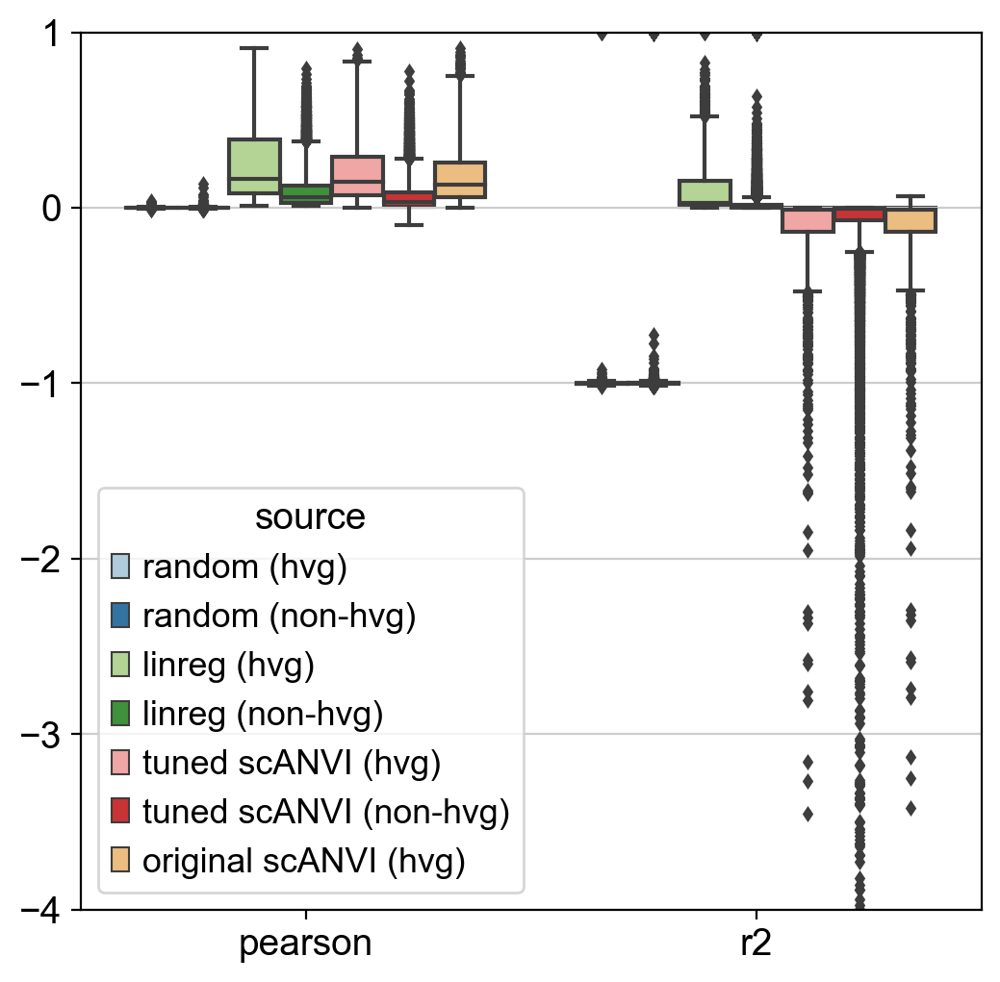

In [89]:
plt.figure(figsize=(6, 6))
sns.boxplot(
    x='variable', y='value', data=res_df.melt(id_vars=['source', 'genes', 'model']), hue='source', palette='Paired',
    hue_order=hue_order,
    whis=2.5, fliersize=3
)
plt.ylim(-4, 1)
plt.xlabel(None)
plt.ylabel(None)

A linear regression produces the best numeric results as well.

Is it possible that non-hvgs are biased towards poor performance because of of differences in mean expression?

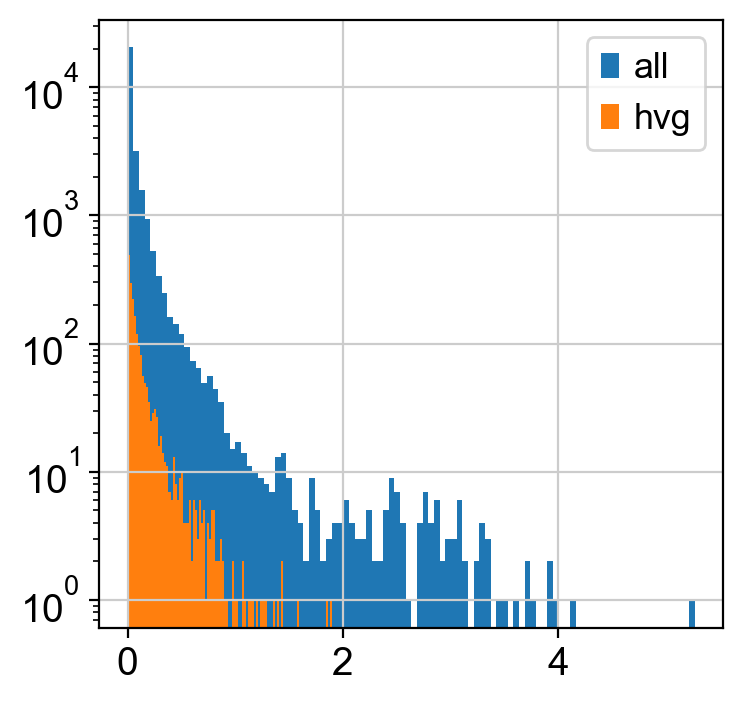

In [93]:
# plot means
plt.hist(full_adata.var.means.values, bins=100, label='all')
plt.hist(subset.var.means.values, bins=100, label='hvg')
plt.yscale('log')
plt.legend()

In [118]:
# bin means
bins = [-1, 0.5, 1, 2, 4, np.inf]
full_adata.var['bins'] = pd.cut(full_adata.var['means'], bins)
res_df['bins'] = res_df['genes'].map(dict(zip(full_adata.var.index, full_adata.var.bins)))

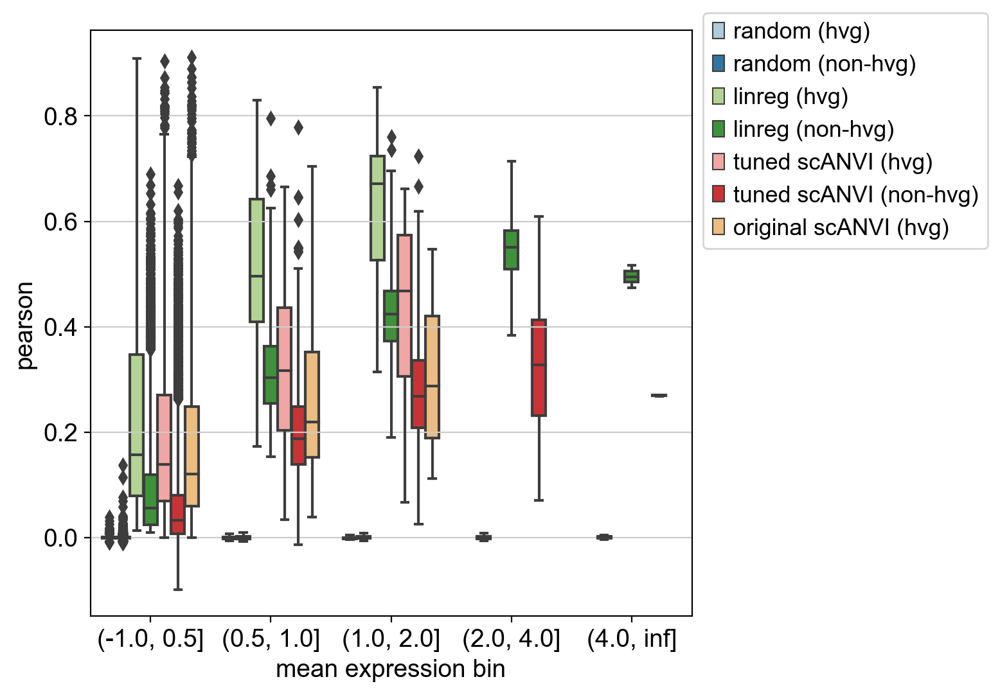

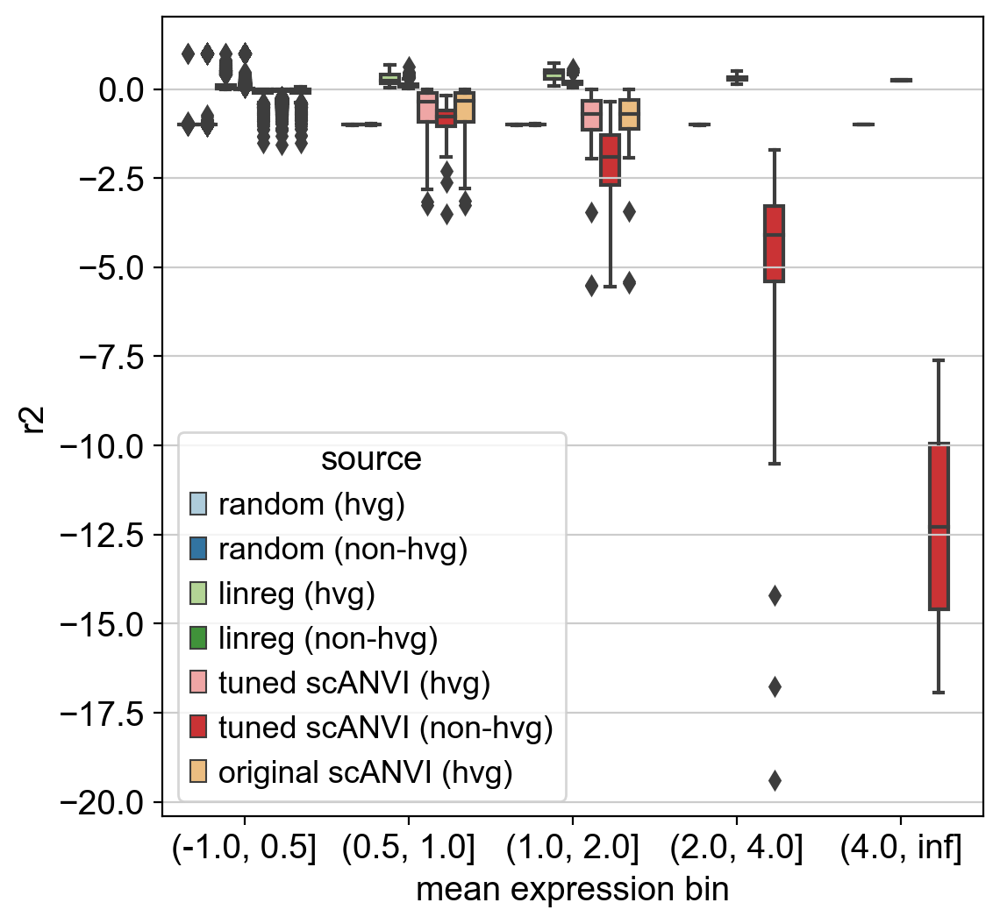

In [120]:
plt.figure(figsize=(6, 6))
sns.boxplot(data=res_df, x='bins', y='pearson', hue='source', palette='Paired', whis=2.5, hue_order=hue_order)
plt.legend(bbox_to_anchor=(1.0, 1.05))
plt.xlabel('mean expression bin')
plt.show()

plt.figure(figsize=(6, 6))
sns.boxplot(data=res_df, x='bins', y='r2', hue='source', palette='Paired', whis=2.5, hue_order=hue_order)
# plt.legend(bbox_to_anchor=(1.0, 1.05))
plt.xlabel('mean expression bin')
plt.show()

So, non-hvgs still systematically perform worse across mean values. Therefore, it's likely that the information for them was insufficiently captured by the remaining highly variable genes.

#### Performance on full dataset
Just to be doubly sure that there is not an additional effect due to re-training on a larger number of classes, we also tried training on the full dataset.

In [ ]:
new_model = scvi.model.SCANVI.load('./scanvi_model_full_genes_full_data/', full_adata)

In [16]:
recon = new_model.get_normalized_expression(full_subset, transform_batch=None)

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


In [12]:
%%time
df, res = construct_res_df(orig_expr, new_recon)

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


CPU times: user 53min 40s, sys: 32min 22s, total: 1h 26min 3s
Wall time: 6min 43s


(-4.0, 1.0)

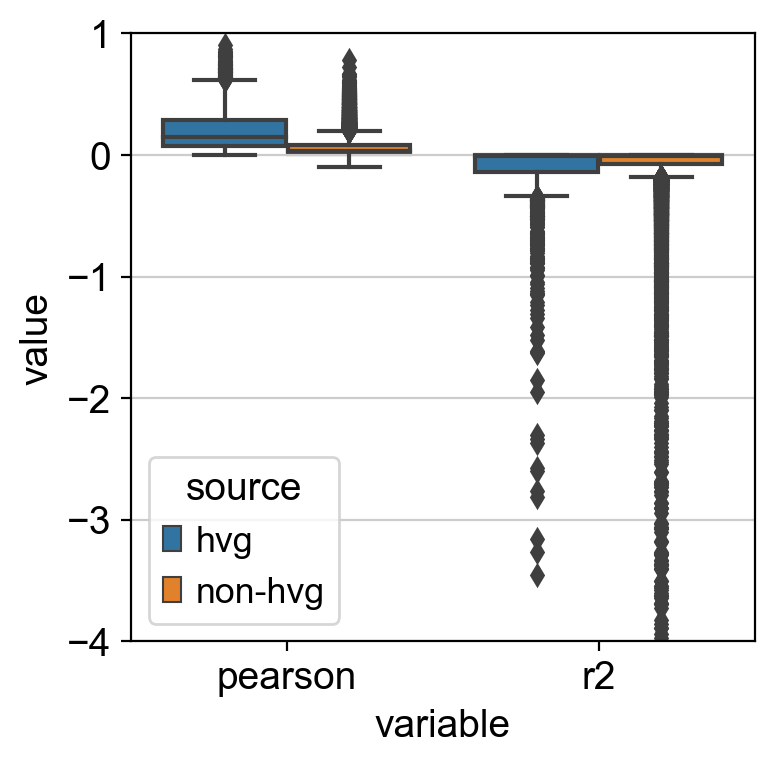

In [23]:
sns.boxplot(x='variable', y='value', data=df.melt(id_vars=['source']), hue='source')
plt.ylim(-4, 1)

In [16]:
print(df[df.source == 'hvg'].mean())
print(df[df.source == 'non-hvg'].mean())

pearson    0.213164
r2        -0.125102
dtype: float64
pearson    0.063005
r2        -0.095565
dtype: float64


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


Essentially no change at all.

#### Specific visualizations
Check reconstruction via UMAP:

In [36]:
# construct anndata
recon_adata = ad.AnnData(recon, obs=full_subset.obs, var=full_subset.var)
recon_adata.uns['scanvi_label_colors'] = full_subset.uns['scanvi_label_colors']

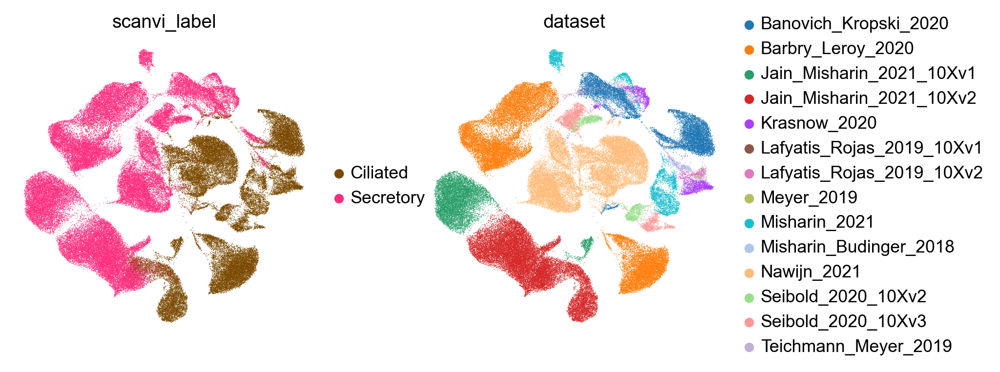

CPU times: user 4min 39s, sys: 9.91 s, total: 4min 49s
Wall time: 2min 27s


In [11]:
%%time
sc.tl.pca(recon_adata)
sc.pp.neighbors(recon_adata)
sc.tl.umap(recon_adata)
sc.pl.umap(recon_adata, color=['scanvi_label', 'dataset'])

Comparing this to block [7] in this notebook, we see that there is much less resolution within each label for whatever variation was not capture by the labels given to scANVI (aka, the model was not able to reconstruct that variation because it was not represented in the latent variables), but there is still most of it.

Visualize these reconstructed values (specifically, the performance difference linreg and the model comes down to zinb reconstruction loss not being measured well with r2)

In [46]:
recon_adata.obs['source'] = 'recon'
full_subset.obs['source'] = 'original'
full_linreg = full_subset.copy()
full_linreg.X = pred = reg.predict(z)
full_linreg.obs['source'] = 'linreg'

both = ad.concat([recon_adata, full_subset, full_linreg])

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


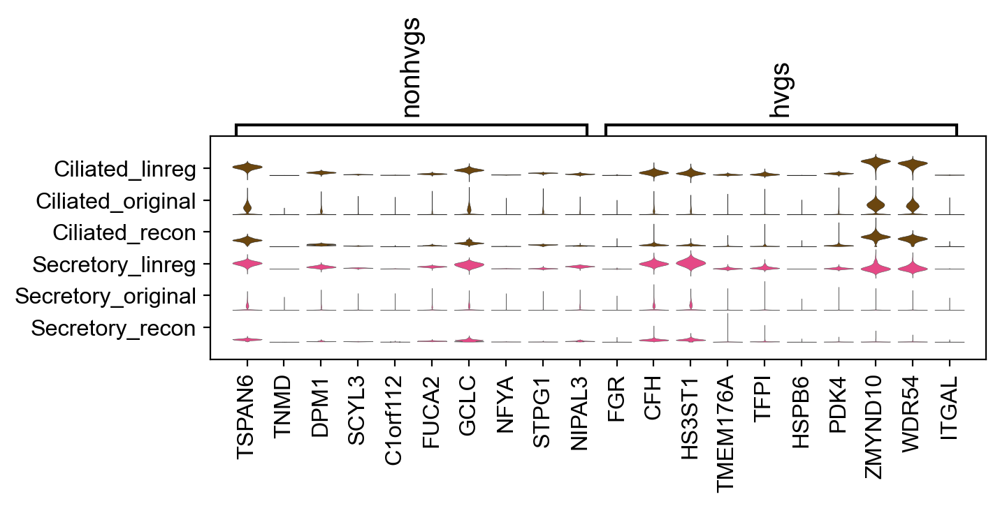

In [56]:
sc.pl.stacked_violin(both, var_names={'non-hvgs':nonhvgs[:10], 'hvgs':hvgs[:10]}, groupby=['scanvi_label', 'source'], rotation=90,
    row_palette=['#7A4900', '#7A4900', '#7A4900', '#FF2F80', '#FF2F80', '#FF2F80'])

### via differentially expressed genes

An important task is that we want to make sure that the reconstructed space retains important information about sub-cell types. We typically decipher our datasets with differential expression, so we'll do that here now.

In [13]:
# which cells are at least somewhat represented across batches
display(subset.obs.manual_ann.value_counts())
cls_to_include = subset.obs.manual_ann.value_counts().loc[lambda x: x>200].index

Multiciliated (non-nasal)    34679
Goblet (nasal)               33921
Club (nasal)                 16322
Club (non-nasal)             10996
Multiciliated (nasal)         4865
Transitional Club-AT2         3125
Suprabasal                    1417
Goblet (bronchial)            1407
Deuterosomal                   997
Goblet (subsegmental)          966
AT2                            374
SMG duct                       173
Basal resting                  134
Alveolar macrophages           123
Ionocyte                        37
DC2                             24
Smooth muscle                   20
AT1                             20
CD8 T cells                     18
EC venous systemic              18
Classical monocytes             16
Peribronchial fibroblasts       15
SMG mucous                      10
Tuft                            10
Non-classical monocytes          8
Adventitial fibroblasts          6
Neuroendocrine                   6
Plasma cells                     5
CD4 T cells         

In [18]:
%%time
recon_dict = {}
for name in ['linreg', 'tuned scANVi', 'random']:
    print(name)
    recon_adata = ad.AnnData(res_dict[name], obs=full_subset.obs, var=full_subset.var)
    recon_adata = recon_adata[recon_adata.obs.manual_ann.isin(cls_to_include)]
    sc.tl.rank_genes_groups(recon_adata, groupby='manual_ann', method='wilcoxon')
    recon_dict[name] = recon_adata

linreg


Trying to set attribute `.uns` of view, copying.
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:421: RuntimeWarning: invalid value encountered in log2
  foldchanges[global_indices]


tuned scANVi


Trying to set attribute `.uns` of view, copying.


random


ValueError: Index of obs must match index of X.

In [19]:
source_adata = full_subset[full_subset.obs.manual_ann.isin(cls_to_include)]

In [20]:
%%time
sc.tl.rank_genes_groups(source_adata, groupby='manual_ann', method='wilcoxon')

Trying to set attribute `.uns` of view, copying.


CPU times: user 4min 50s, sys: 34.8 s, total: 5min 25s
Wall time: 5min 35s


#### spearman correlation of differentially expressed genes

In [24]:
from scipy.stats import spearmanr

In [30]:
%%time
method_sprs = {}
for name, recon_adata in recon_dict.items():
    sprs = {}
    for ct in source_adata.obs.manual_ann.cat.categories:
        df_recon = sc.get.rank_genes_groups_df(recon_adata, group=ct).set_index('names')
        df_source = sc.get.rank_genes_groups_df(source_adata, group=ct).set_index('names')
        df = df_source.join(df_recon, how='inner', rsuffix='_recon')
        sprs[ct] = spearmanr(df['scores'].values, df['scores_recon'].values)[0]
    
    method_sprs[name] = list(sprs.values())

CPU times: user 15.3 s, sys: 12.2 ms, total: 15.3 s
Wall time: 15.3 s


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/ipykernel_launcher.py:3: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  This is separate from the ipykernel package so we can avoid doing imports until


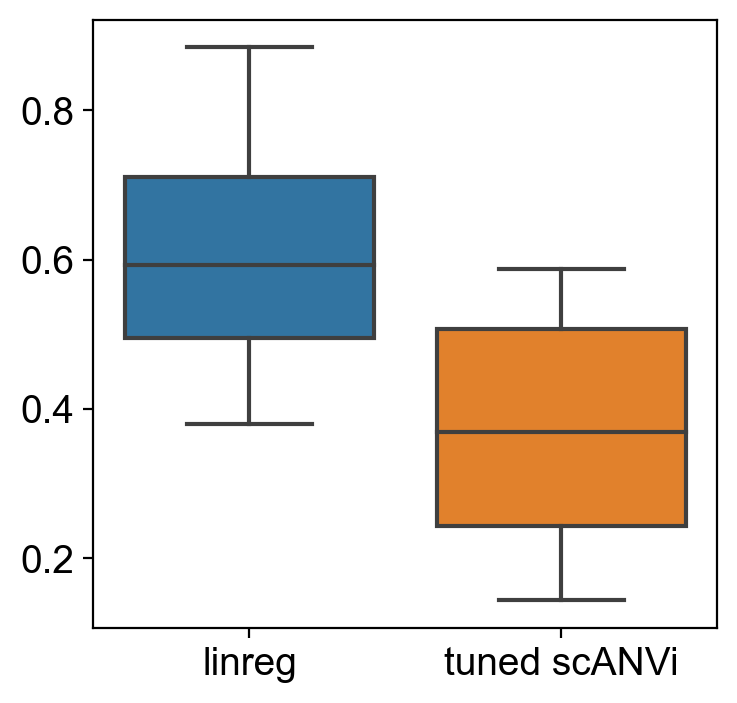

In [37]:
sprs_df = pd.DataFrame.from_dict(method_sprs, orient='index', columns=source_adata.obs.manual_ann.cat.categories)
sns.boxplot(data=sprs_df.T)
plt.grid(b=False)

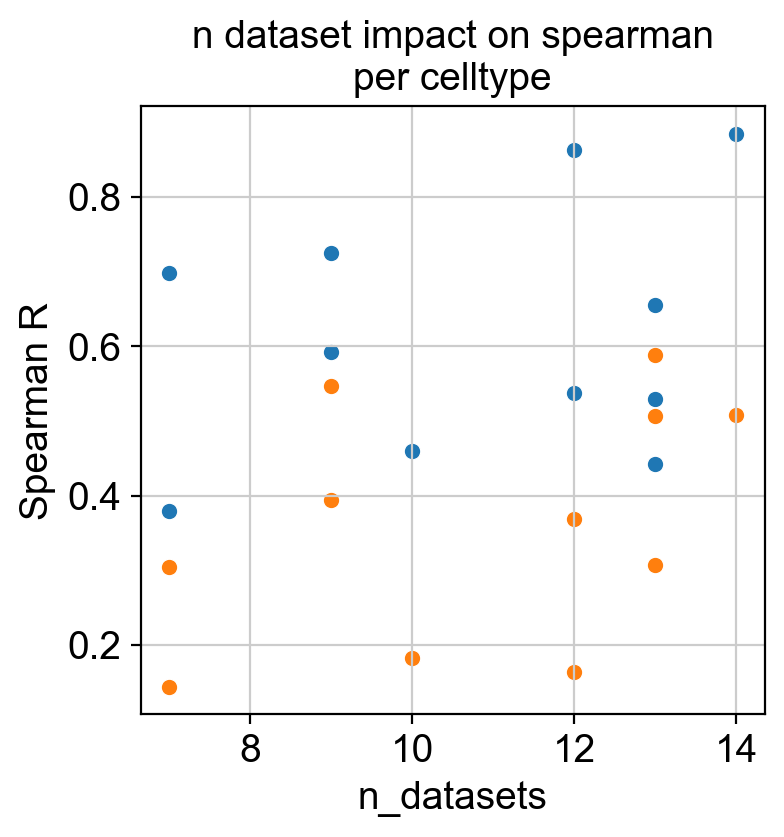

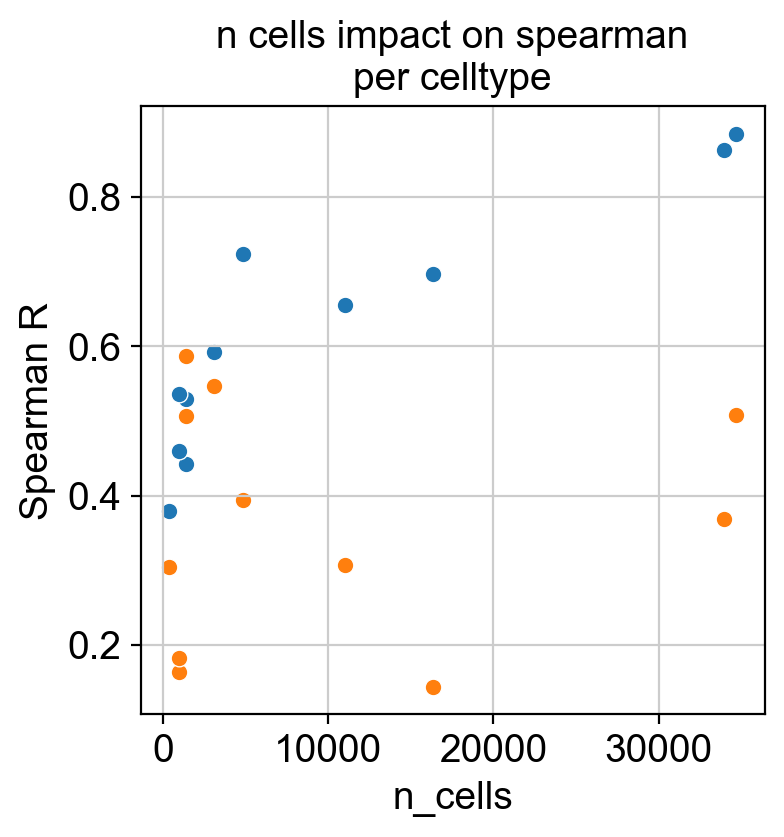

In [49]:
# assess if performance was correlated with number of batches the cell type appeared in
occ_df = pd.DataFrame(
        pd.crosstab(source_adata.obs.dataset, source_adata.obs.manual_ann).astype(bool).sum(axis=0)
    ).rename(columns={0:'n_datasets'}).join(
        sprs_df.T.rename(columns={0:'corr'})
)
sns.scatterplot(x='n_datasets', y='linreg', data=occ_df)
sns.scatterplot(x='n_datasets', y='tuned scANVi', data=occ_df)
plt.title('n dataset impact on spearman\nper celltype')
plt.ylabel('Spearman R')
plt.show()

# assess if correlated with number of cells
occ_df = pd.DataFrame(source_adata.obs.manual_ann.value_counts()).rename(columns={'manual_ann':'n_cells'}).join(
        sprs_df.T.rename(columns={0:'corr'})
)
sns.scatterplot(x='n_cells', y='linreg', data=occ_df)
sns.scatterplot(x='n_cells', y='tuned scANVi', data=occ_df)
plt.title('n cells impact on spearman\nper celltype')
plt.ylabel('Spearman R')
plt.show()

The very positive trend for linear regression suggests that >30k cells per cell type can lead to quite good performance.

#### comparison of ranking of markers using a marker gene list

In [36]:
# parse marker gene dictionary from csv
marker_df = pd.read_csv('markergenes.csv', index_col=0)

marker_dict = {}
for i in range(0, marker_df.shape[1], 3):
    ct = marker_df.columns[i].split('_')[0]
    l = list(marker_df[
#         marker_df[f'{ct}_marker_for'] == ct
        marker_df[f'{ct}_marker_for'].isin([ct, f'{ct} (poss. lowly expressed, non-unique)'])
    ][f'{ct}_marker'].values)
    # some markers are skipped due to uncertainty in annotation
    if len(l) > 0:
        marker_dict[ct] = l
marker_dict

{'AT0': ['SFTPB', 'SCGB3A2', 'SFTA2'],
 'AT1': ['CLIC5', 'SPOCK2', 'TIMP3'],
 'AT2 proliferating': ['CENPW', 'CDKN3', 'BIRC5'],
 'AT2': ['MFSD2A', 'C8orf4', 'C11orf96'],
 'Adventitial fibroblasts': ['MFAP5', 'SCARA5', 'PI16'],
 'Alveolar Mph CCL3+': ['CCL20', 'FAM89A'],
 'Alveolar Mph MT-positive': ['MT1M', 'CCL18', 'MT1E'],
 'Alveolar Mph proliferating': ['TYMS', 'CENPW', 'MND1'],
 'Alveolar fibroblasts': ['SPINT2', 'LIMCH1', 'FGFR4'],
 'Alveolar macrophages': ['CYP27A1', 'MARCO', 'FABP4'],
 'B cells': ['MS4A1'],
 'Basal resting': ['KRT15', 'KRT17', 'TP63'],
 'CD8 T cells': ['CD8A', 'CD8B', 'TRGC2'],
 'Classical monocytes': ['S100A12', 'FCN1', 'RNASE2'],
 'Club (nasal)': ['SERPINB3', 'TCN1', 'ASRGL1'],
 'Club (non-nasal)': ['CYP2F1', 'SCGB3A1', 'BPIFB1'],
 'DC1': ['XCR1', 'CLEC9A', 'CLNK'],
 'DC2': ['PKIB', 'CLEC10A', 'CD1E'],
 'Deuterosomal': ['CDC20B', 'KDELC2', 'E2F7'],
 'EC aerocyte capillary': ['SOSTDC1'],
 'EC arterial': ['DKK2', 'IGFBP3'],
 'EC general capillary': ['IL7R', 'FCN

In [77]:
n_recap = {}
genes = []
for name, recon_adata in recon_dict.items():
    diffs = []
    for ct in source_adata.obs.manual_ann.cat.categories:
        df_recon = sc.get.rank_genes_groups_df(recon_adata, group=ct).set_index('names')
        df_recon['i'] = range(df_recon.shape[0])
        df_source = sc.get.rank_genes_groups_df(source_adata, group=ct).set_index('names')
        df_source['i'] = range(df_recon.shape[0])
        try:
            for gene in marker_dict[ct]:
                diffs.append(df_recon.loc[gene].i - df_source.loc[gene].i)
                genes.append(gene + ' ' + ct)
        except KeyError:
            pass
        
    n_recap[name] = diffs
n_recap['genes'] = genes[:28]  # halved bc loop

<AxesSubplot:>

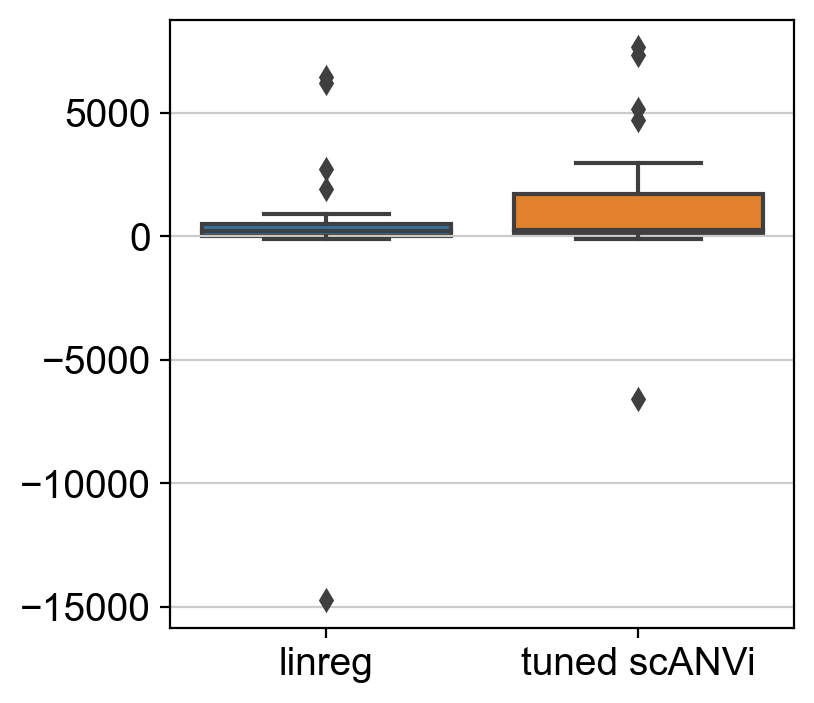

In [80]:
ranks = pd.DataFrame.from_dict(n_recap)
sns.boxplot(data=ranks)

In [79]:
ranks[ranks.linreg < 0]

,linreg,tuned scANVi,genes
4,-49.0,-47.0,E2F7 Deuterosomal
6,-14728.0,-6594.0,LYPD2 Multiciliated (nasal)
27,-127.0,-135.0,C11orf96 AT2


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scanpy/plotting/_baseplot_class.py:511: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  color_legend_ax, orientation='horizontal', cmap=cmap, norm=normalize


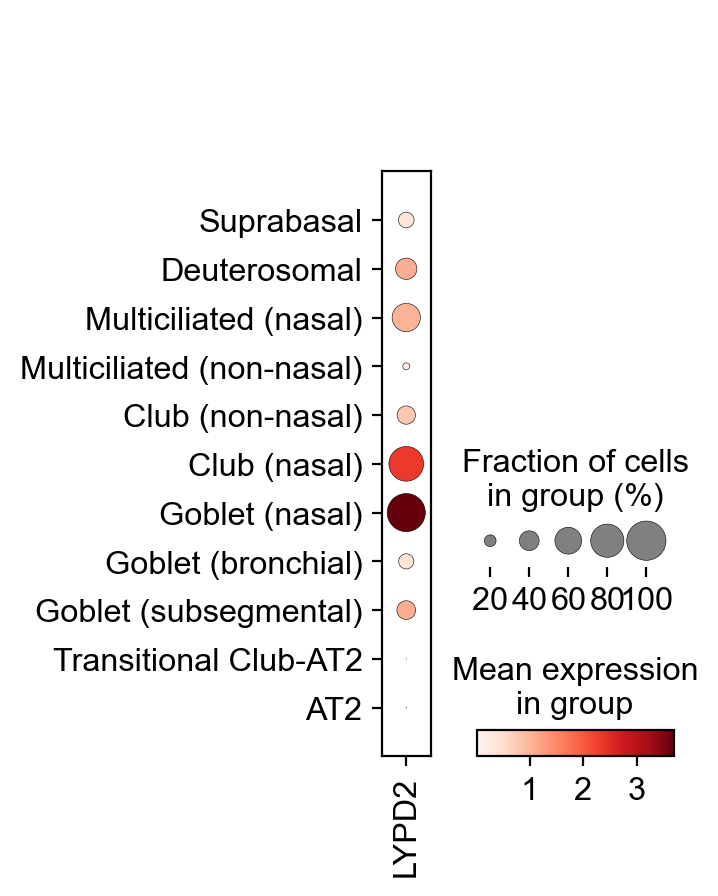

In [76]:
sc.pl.dotplot(source_adata, var_names=['LYPD2'], groupby='manual_ann')

Interestingly, both models pick up the LYPD2 marker better than the original data, from which LYPD2 is not detected as a marker genes of nasal multiciliated cells from differential expression.

In [75]:
pd.DataFrame.from_dict(n_recap).median()

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


linreg          195.0
tuned scANVi    250.5
dtype: float64

Cell type markers are ranked about 195 ranks lower by the linear regression reconstructed values.

Example of failure - AT2 marker as identified by the reconstructed data, but with non-visible differential expression:

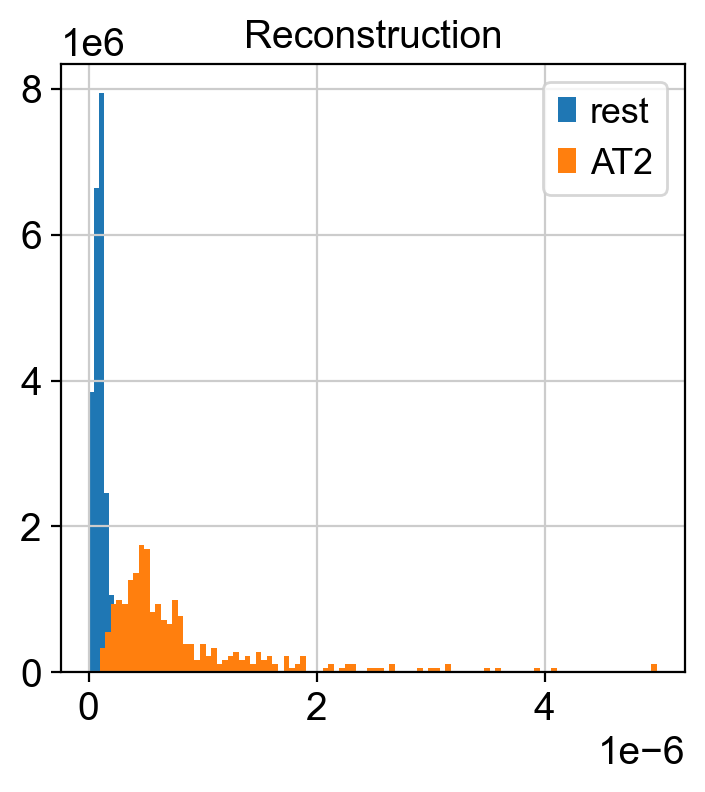

In [103]:
plt.hist(list(recon_adata[recon_adata.obs.manual_ann != 'AT2'][:, 'LAMP5'].X[:, 0]), bins=100, density=True, label='rest')
plt.hist(list(recon_adata[recon_adata.obs.manual_ann == 'AT2'][:, 'LAMP5'].X[:, 0]), bins=100, density=True, label='AT2')
plt.title('Reconstruction')
plt.legend()

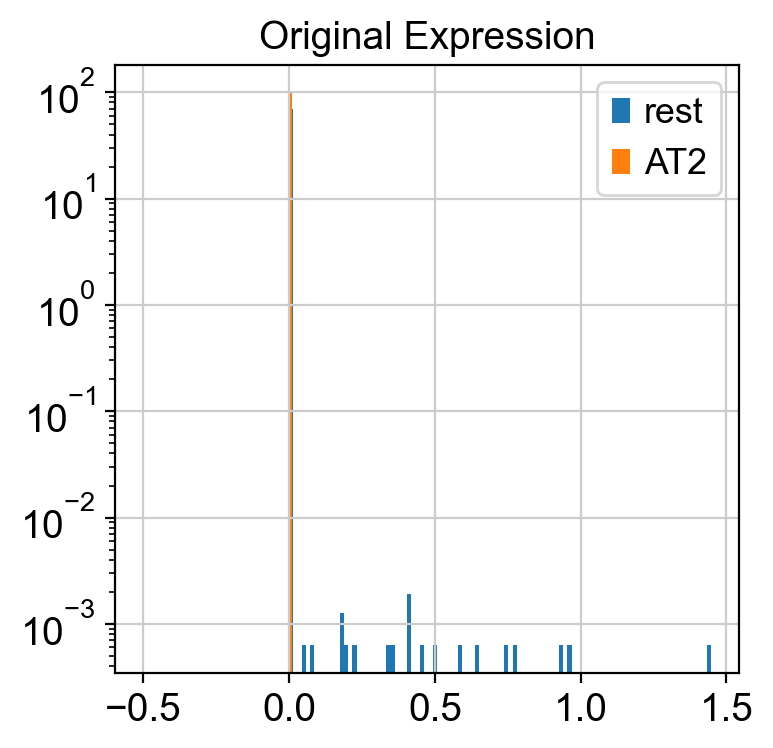

In [102]:
plt.hist(list(source_adata[source_adata.obs.manual_ann != 'AT2'][:, 'LAMP5'].X[:, 0].toarray().flatten()), bins=100, density=True, label='rest')
plt.hist(list(source_adata[source_adata.obs.manual_ann == 'AT2'][:, 'LAMP5'].X[:, 0].toarray().flatten()), bins=100, density=True, label='AT2')
plt.title('Original Expression')
plt.yscale('log')
plt.legend()

### via removal of batch effect

We also want to see whether and how cleanly batch effects are removed in the reconstructed space. For this, we will use the example of AT2 cell ambient marker RNA in Macrophages.

In [117]:
example_subset = full_adata[full_adata.obs.scanvi_label.isin(['Macrophages', 'AT1', 'AT2'])]

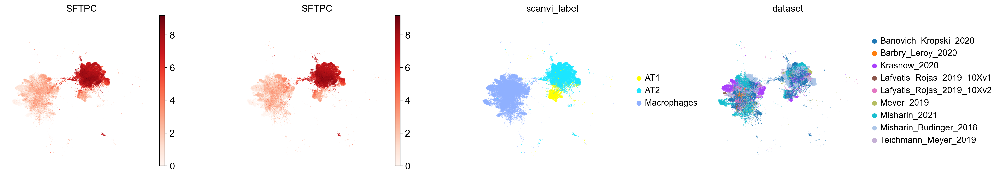

In [118]:
sc.pl.umap(example_subset, color=['SFTPC', 'SFTPC', 'scanvi_label','dataset'], wspace=.4)

Observe original expression:

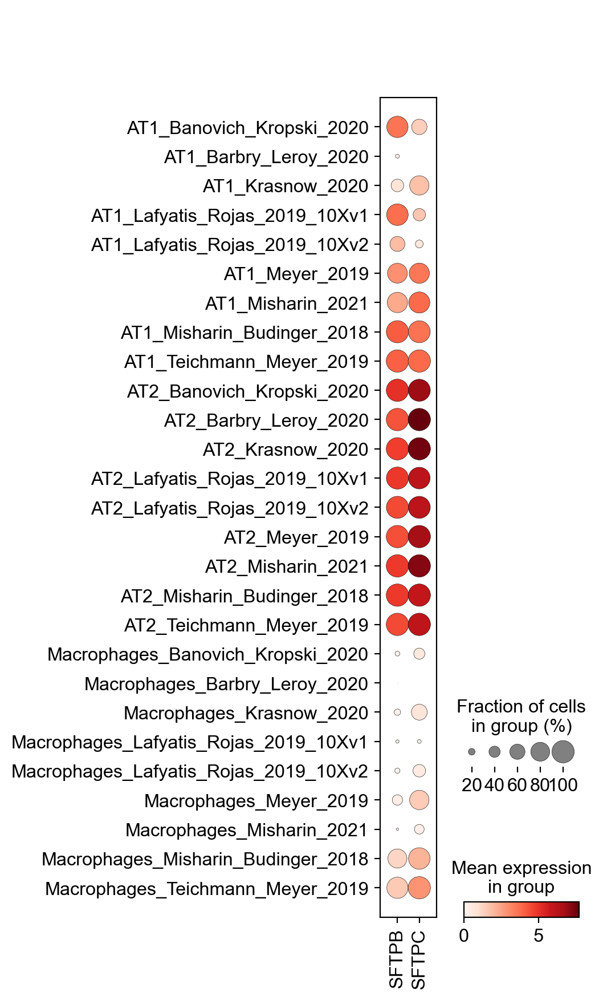

In [120]:
sc.pl.dotplot(example_subset, var_names=['SFTPB', 'SFTPC'], groupby=['scanvi_label', 'dataset'])

We see that incorrect expression is removed regardless of which batch is reconstructed.

Misharin_Budinger_2018


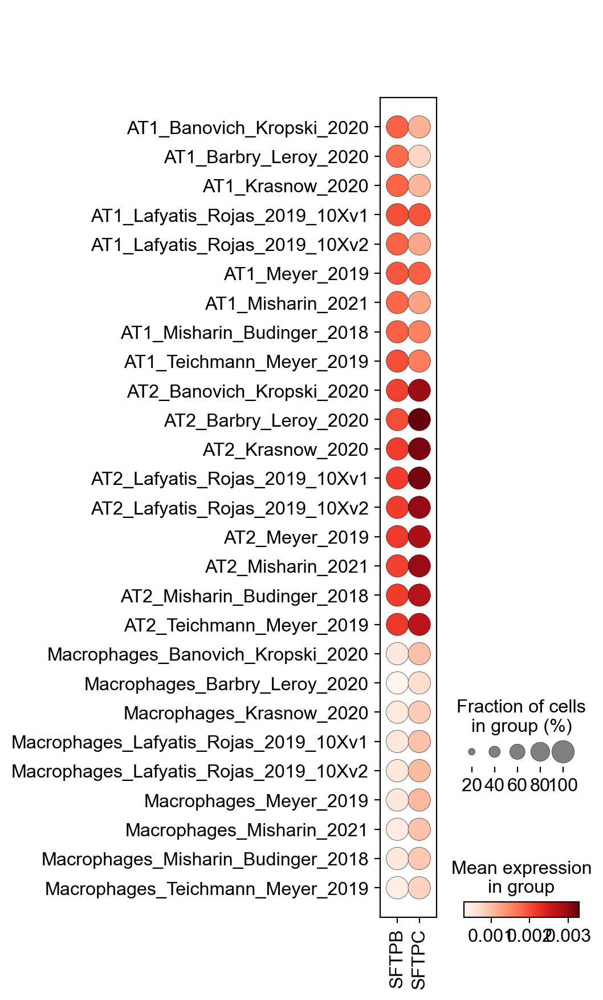

Krasnow_2020


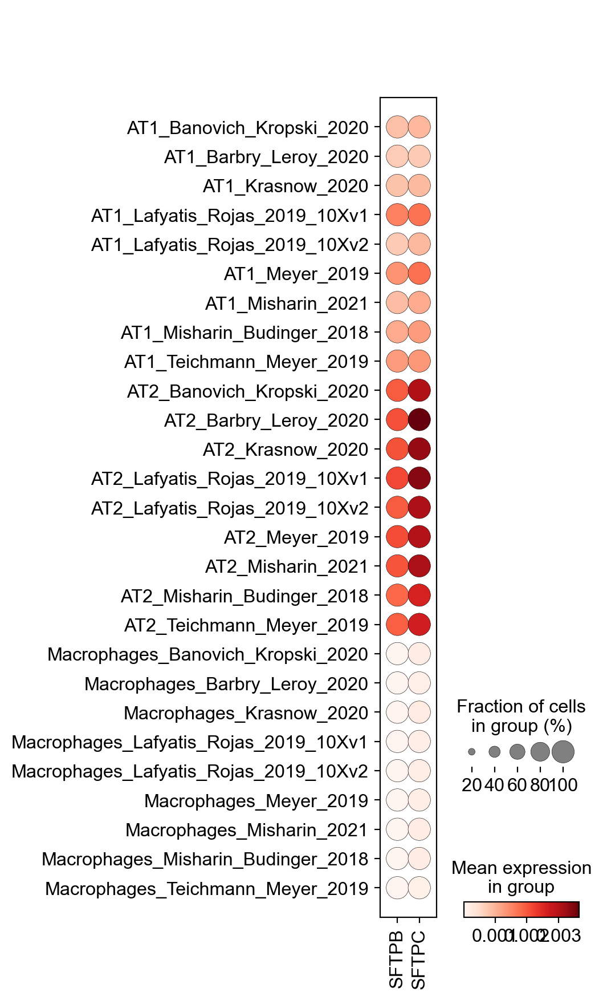

Seibold_2020_10Xv3


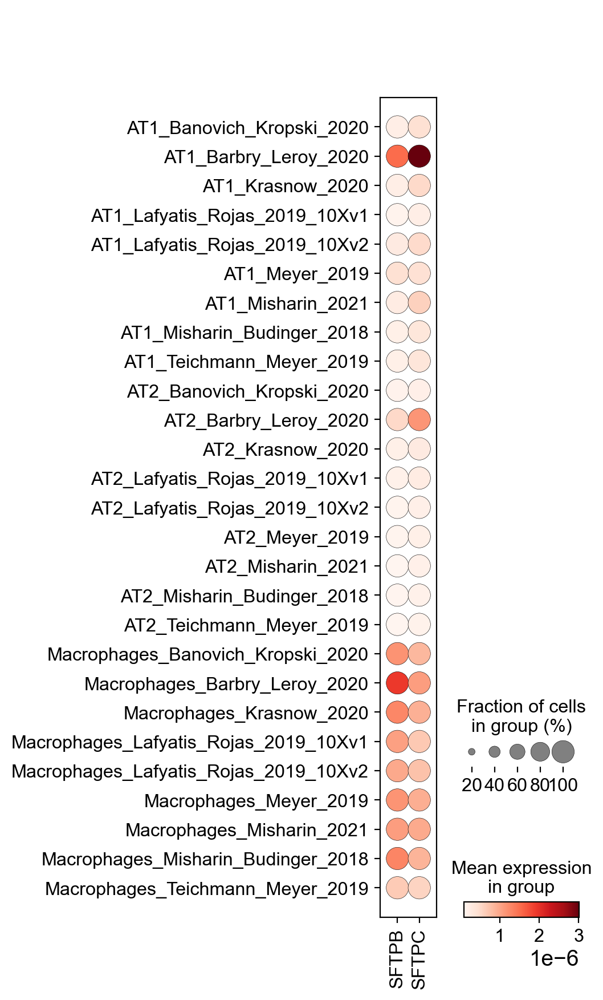

Banovich_Kropski_2020


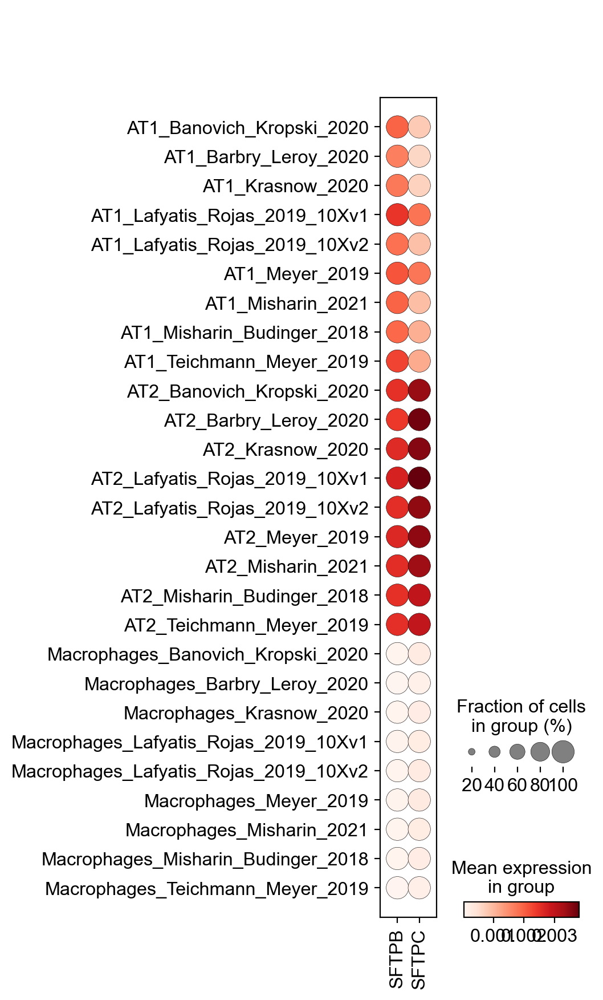

Nawijn_2021


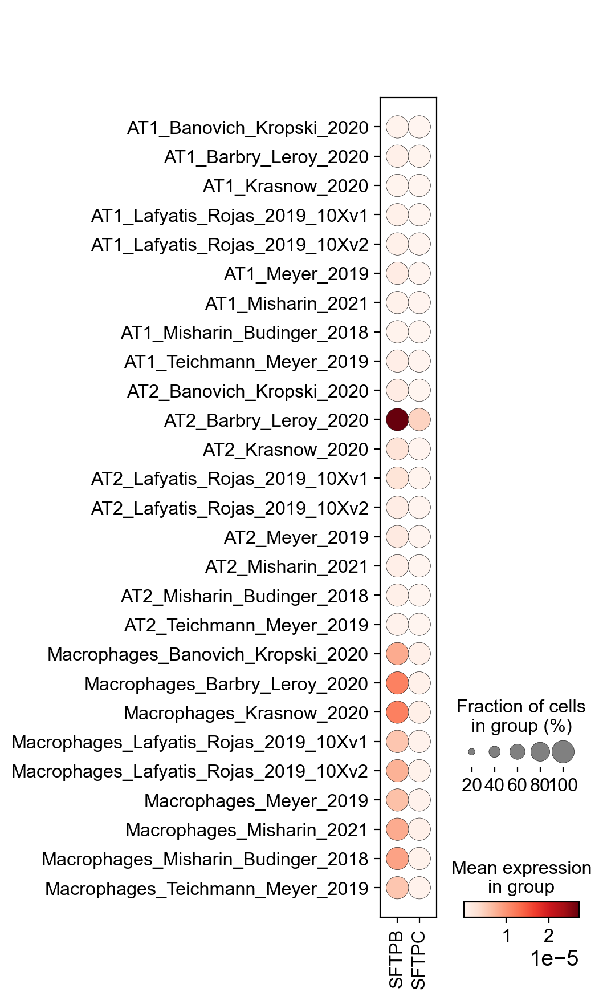

Misharin_2021


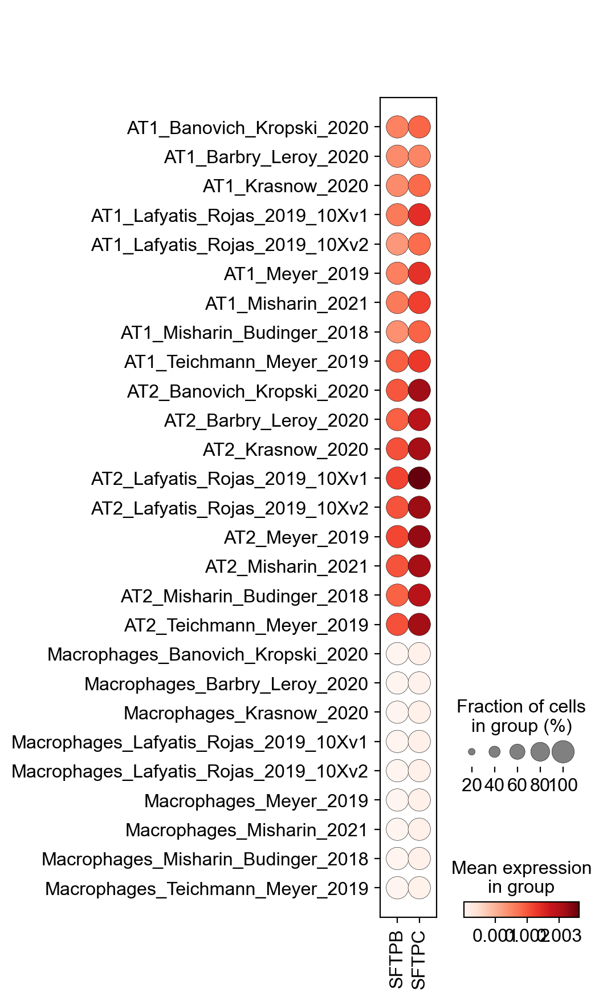

Seibold_2020_10Xv2


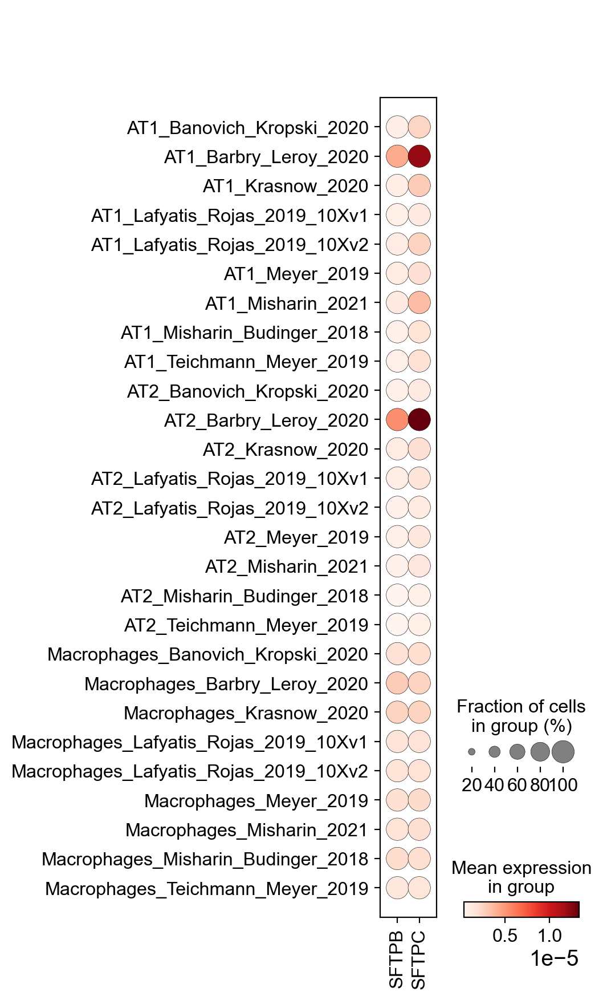

Barbry_Leroy_2020


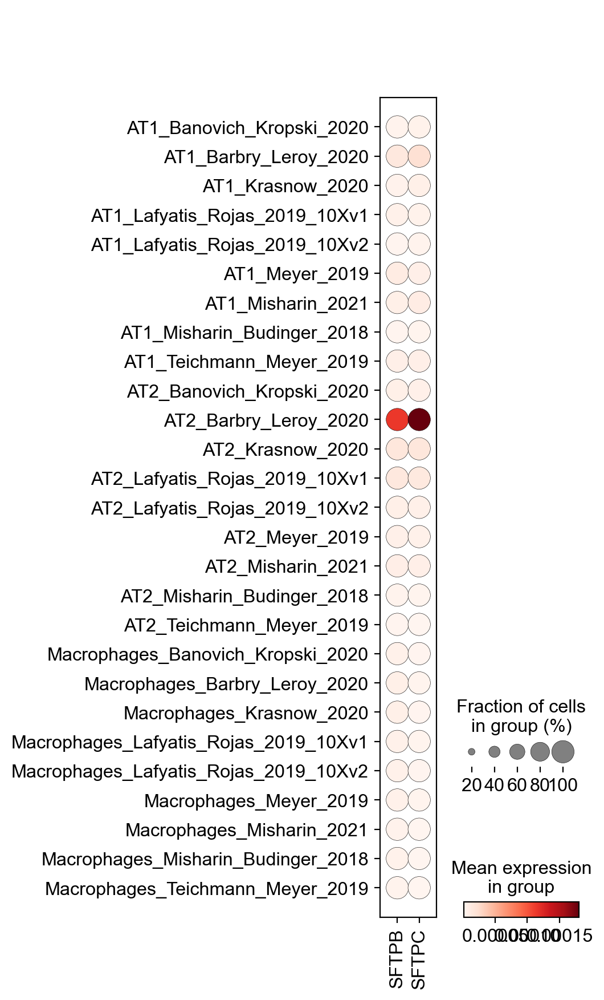

Teichmann_Meyer_2019


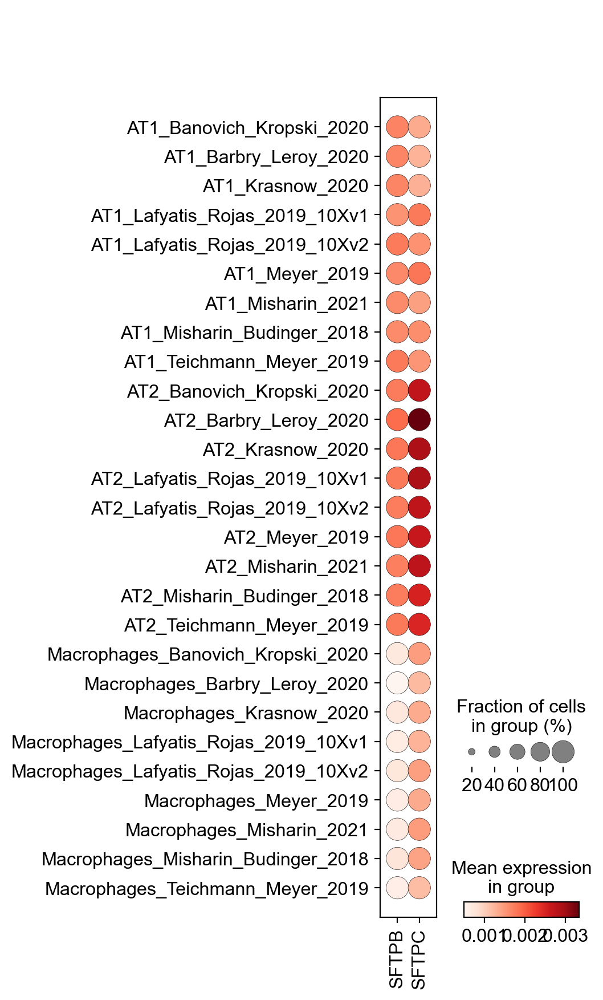

Lafyatis_Rojas_2019_10Xv1


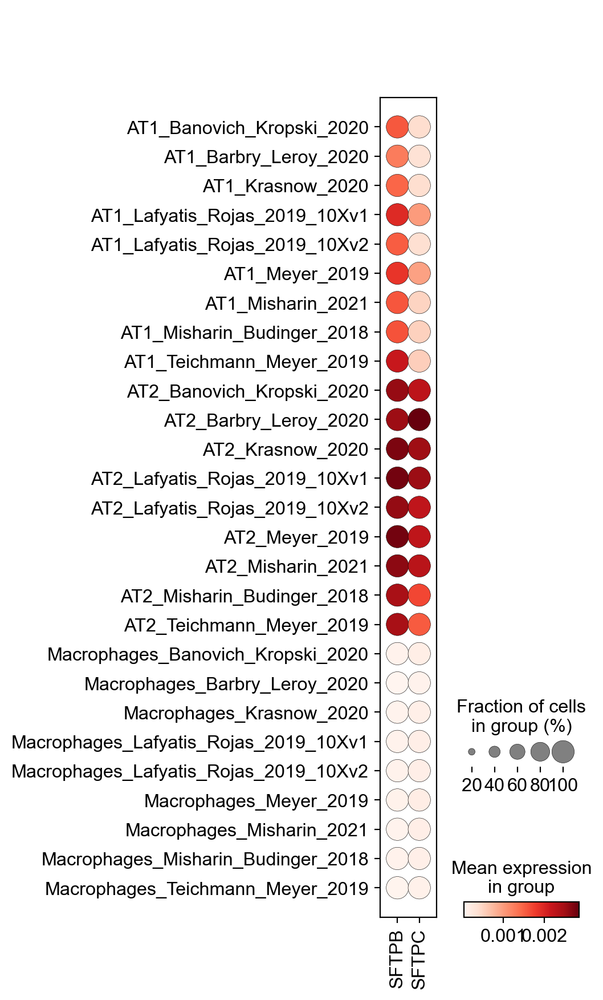

Lafyatis_Rojas_2019_10Xv2


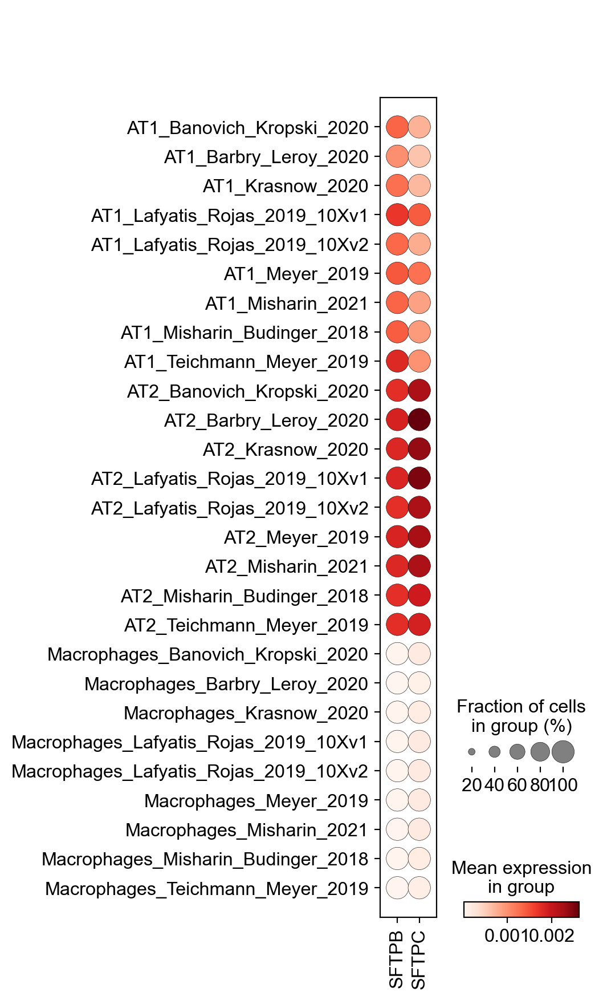

Meyer_2019


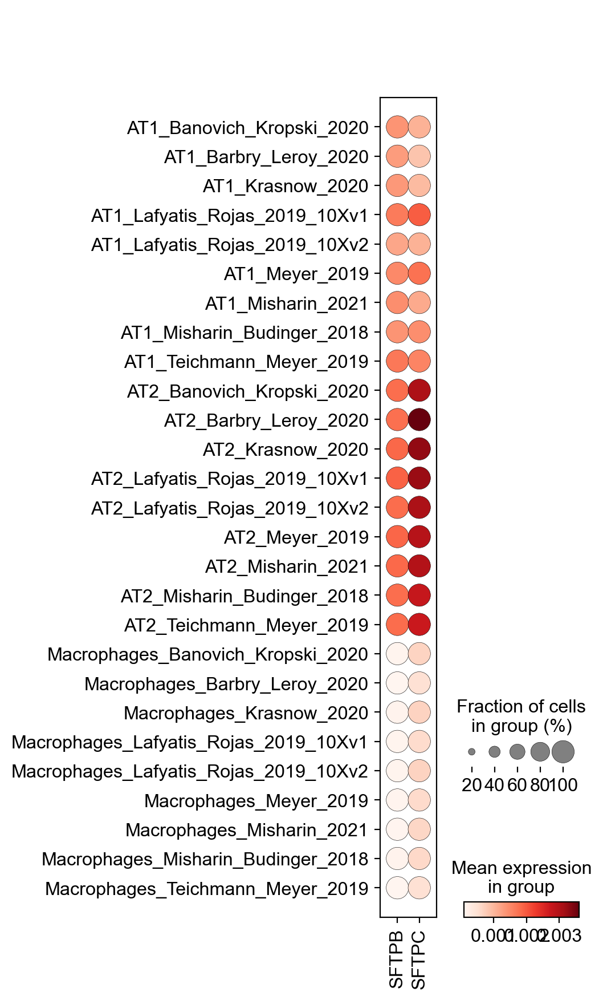

Jain_Misharin_2021_10Xv2


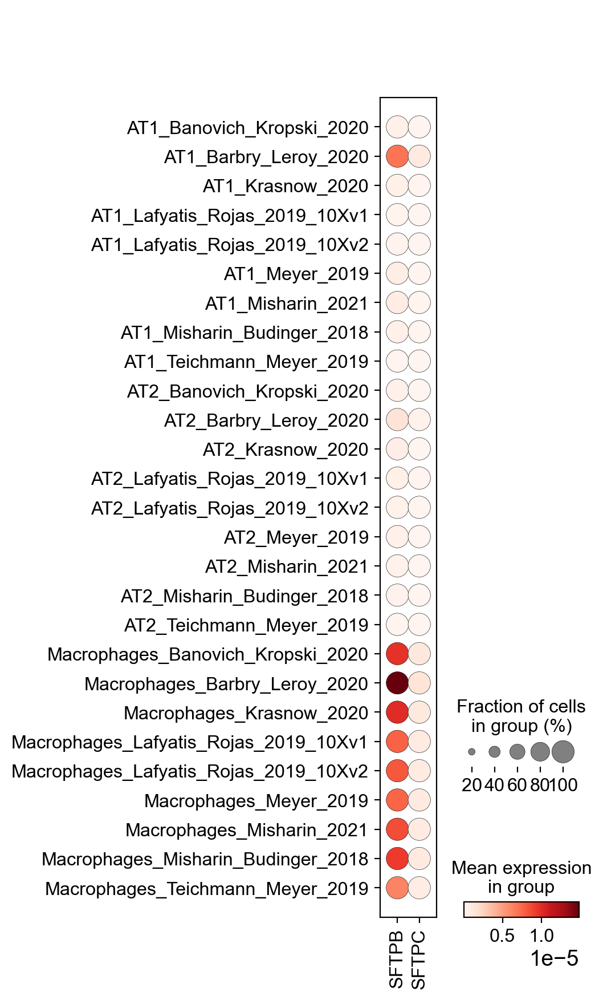

Jain_Misharin_2021_10Xv1


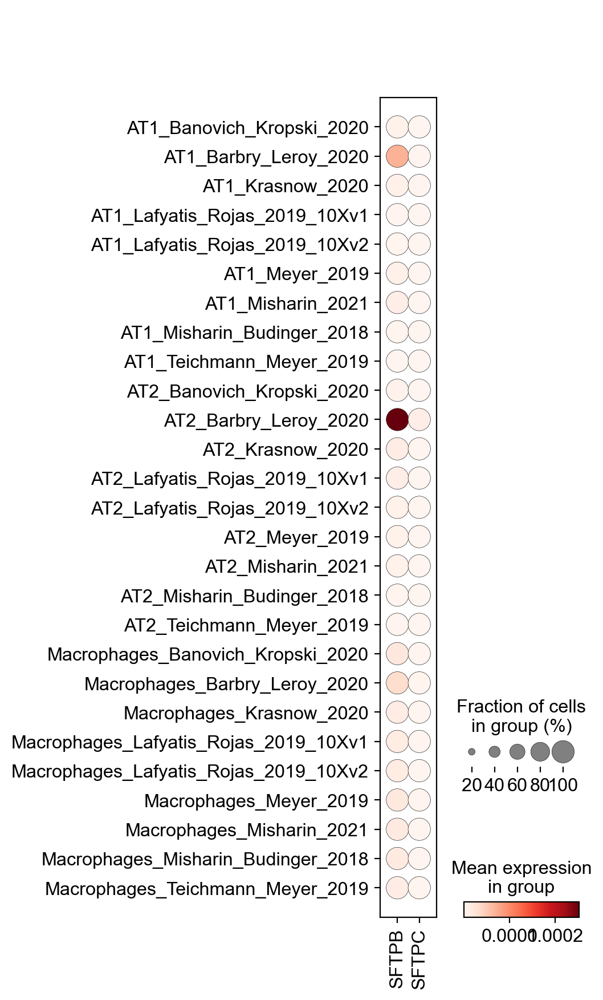

CPU times: user 10min 17s, sys: 2min 8s, total: 12min 25s
Wall time: 12min 27s


In [126]:
%%time
for target_batch in adata.obs.dataset.unique():
    print(target_batch)
    recon = new_model.get_normalized_expression(example_subset, transform_batch=target_batch)

    # construct anndata
    recon_adata = ad.AnnData(recon, obs=example_subset.obs, var=example_subset.var)
    recon_adata.uns['scanvi_label_colors'] = example_subset.uns['scanvi_label_colors']
    sc.pl.dotplot(recon_adata, var_names=['SFTPB', 'SFTPC'], groupby=['scanvi_label', 'dataset'])

But much less so in the null batch:

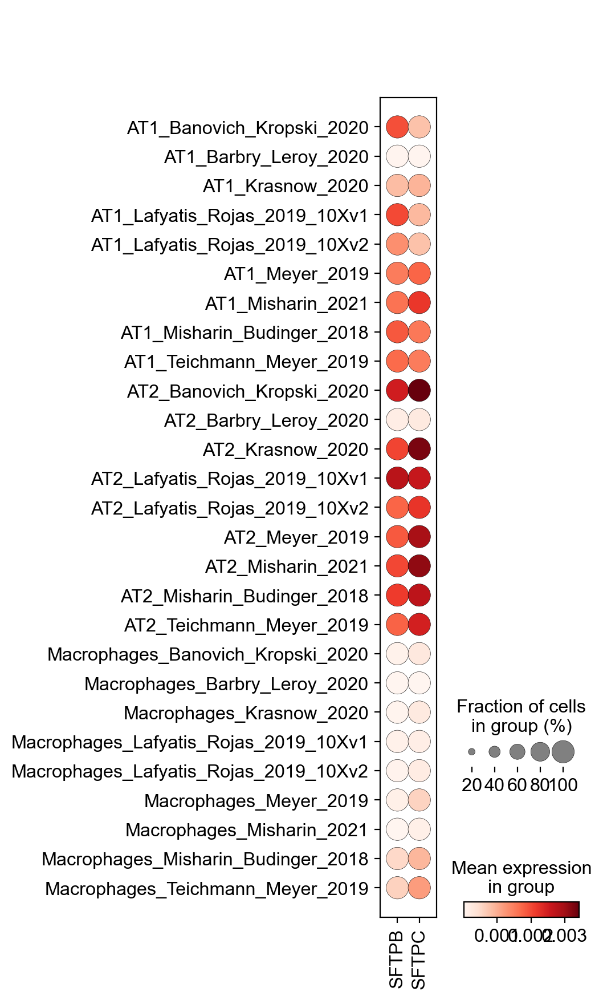

In [130]:
recon = new_model.get_normalized_expression(example_subset, transform_batch=None)

# construct anndata
recon_adata = ad.AnnData(recon, obs=example_subset.obs, var=example_subset.var)
recon_adata.uns['scanvi_label_colors'] = example_subset.uns['scanvi_label_colors']
sc.pl.dotplot(recon_adata, var_names=['SFTPB', 'SFTPC'], groupby=['scanvi_label', 'dataset'])